# Deep Convolutional GANs

In this notebook, you'll build a GAN using convolutional layers in the generator and discriminator. This is called a Deep Convolutional GAN, or DCGAN for short. The DCGAN architecture was first explored last year and has seen impressive results in generating new images, you can read the [original paper here](https://arxiv.org/pdf/1511.06434.pdf).

You'll be training DCGAN on the [Street View House Numbers](http://ufldl.stanford.edu/housenumbers/) (SVHN) dataset. These are color images of house numbers collected from Google street view. SVHN images are in color and much more variable than MNIST. 

![SVHN Examples](assets/SVHN_examples.png)

So, we'll need a deeper and more powerful network. This is accomplished through using convolutional layers in the discriminator and generator. It's also necessary to use batch normalization to get the convolutional networks to train. The only real changes compared to what [you saw previously](https://github.com/udacity/deep-learning/tree/master/gan_mnist) are in the generator and discriminator, otherwise the rest of the implementation is the same.

In [1]:
%matplotlib inline

import pickle as pkl

import matplotlib.pyplot as plt
import numpy as np
from scipy.io import loadmat
import tensorflow as tf

In [2]:
!mkdir data

mkdir: cannot create directory ‘data’: File exists


## Getting the data

Here you can download the SVHN dataset. Run the cell above and it'll download to your machine.

In [3]:
from urllib.request import urlretrieve
from os.path import isfile, isdir
from tqdm import tqdm

data_dir = 'data/'

if not isdir(data_dir):
    raise Exception("Data directory doesn't exist!")

class DLProgress(tqdm):
    last_block = 0

    def hook(self, block_num=1, block_size=1, total_size=None):
        self.total = total_size
        self.update((block_num - self.last_block) * block_size)
        self.last_block = block_num

if not isfile(data_dir + "train_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Training Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/train_32x32.mat',
            data_dir + 'train_32x32.mat',
            pbar.hook)

if not isfile(data_dir + "test_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Testing Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/test_32x32.mat',
            data_dir + 'test_32x32.mat',
            pbar.hook)

These SVHN files are `.mat` files typically used with Matlab. However, we can load them in with `scipy.io.loadmat` which we imported above.

In [4]:
trainset = loadmat(data_dir + 'train_32x32.mat')
testset = loadmat(data_dir + 'test_32x32.mat')

Here I'm showing a small sample of the images. Each of these is 32x32 with 3 color channels (RGB). These are the real images we'll pass to the discriminator and what the generator will eventually fake.

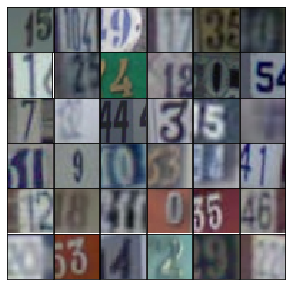

In [5]:
idx = np.random.randint(0, trainset['X'].shape[3], size=36)
fig, axes = plt.subplots(6, 6, sharex=True, sharey=True, figsize=(5,5),)
for ii, ax in zip(idx, axes.flatten()):
    ax.imshow(trainset['X'][:,:,:,ii], aspect='equal')
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
plt.subplots_adjust(wspace=0, hspace=0)

Here we need to do a bit of preprocessing and getting the images into a form where we can pass batches to the network. 
First off, we need to rescale the images to a range of -1 to 1, since the output of our generator is also in that range. 
We also have a set of test and validation images which could be used if we're trying to identify the numbers in the images.

In [6]:
# Scale works the same as tanh
def scale(x, feature_range=(-1, 1)):
    # scale to (0, 1)
    x = ((x - x.min())/(255 - x.min()))
    
    # scale to feature_range
    min, max = feature_range
    x = x * (max - min) + min
    return x

In [7]:
class Dataset:
    def __init__(self, train, test, val_frac=0.5, shuffle=False, scale_func=None):
        split_idx = int(len(test['y'])*(1 - val_frac))
        self.test_x, self.valid_x = test['X'][:,:,:,:split_idx], test['X'][:,:,:,split_idx:]
        self.test_y, self.valid_y = test['y'][:split_idx], test['y'][split_idx:]
        self.train_x, self.train_y = train['X'], train['y']
        
        self.train_x = np.rollaxis(self.train_x, 3)
        self.valid_x = np.rollaxis(self.valid_x, 3)
        self.test_x = np.rollaxis(self.test_x, 3)
        
        if scale_func is None:
            self.scaler = scale
        else:
            self.scaler = scale_func
        self.shuffle = shuffle
        
    def batches(self, batch_size):
        if self.shuffle:
            idx = np.arange(len(self.train_x))
            np.random.shuffle(idx)
            self.train_x = self.train_x[idx]
            self.train_y = self.train_y[idx]
        
        n_batches = len(self.train_y)//batch_size
        for ii in range(0, len(self.train_y), batch_size):
            x = self.train_x[ii:ii+batch_size]
            y = self.train_y[ii:ii+batch_size]
            
            yield self.scaler(x), y

## Network Inputs

Here, just creating some placeholders like normal.

In [9]:
def model_inputs(real_dim):
    inputs_real = tf.placeholder(tf.float32, (None, *real_dim), name='input_real')
    
    return inputs_real

## Generator

Here you'll build the generator network. The input will be our noise vector `z` as before. Also as before, the output will be a $tanh$ output, but this time with size 32x32 which is the size of our SVHN images.

What's new here is we'll use convolutional layers to create our new images. The first layer is a fully connected layer which is reshaped into a deep and narrow layer, something like 4x4x1024 as in the original DCGAN paper. Then we use batch normalization and a leaky ReLU activation. Next is a transposed convolution where typically you'd halve the depth and double the width and height of the previous layer. Again, we use batch normalization and leaky ReLU. For each of these layers, the general scheme is convolution > batch norm > leaky ReLU.

You keep stacking layers up like this until you get the final transposed convolution layer with shape 32x32x3. Below is the archicture used in the original DCGAN paper:

![DCGAN Generator](assets/dcgan.png)

Note that the final layer here is 64x64x3, while for our SVHN dataset, we only want it to be 32x32x3.

In [10]:
# tf.layers.conv2d(
#     inputs, ----------
#     filters, -------------
#     kernel_size, ------------
#     strides=(1, 1), ---------------
#     padding='valid', ------------
#     data_format='channels_last', -------------> NHWC and not NCHW
#     dilation_rate=(1, 1), -------------------
#     activation=None,
#     use_bias=True, ------------------
#     kernel_initializer=None,
#     bias_initializer=tf.zeros_initializer(), ------------------
#     kernel_regularizer=None,
#     bias_regularizer=None,
#     activity_regularizer=None,
#     kernel_constraint=None,
#     bias_constraint=None,
#     trainable=True, ---------------------
#     name=None,
#     reuse=None
# )

In [17]:
def generator(inputs, output_dim, reuse=False, alpha=0.1, training=True):
    with tf.variable_scope('generator', reuse=reuse):
        # Input layer is 32x32x3
        h1 = tf.layers.conv2d(inputs=inputs, filters=64, kernel_size=5, strides=2, padding='same')
        bn1 = tf.layers.batch_normalization(h1, training=training)
        nl1 = tf.maximum(alpha * bn1, bn1)
        # 16x16x64
        
        h2 = tf.layers.conv2d(inputs=nl1, filters=128, kernel_size=5, strides=2, padding='same')
        bn2 = tf.layers.batch_normalization(h2, training=training)
        nl2 = tf.maximum(alpha * bn2, bn2)
        # 8x8x128
        
        h3 = tf.layers.conv2d(inputs=nl2, filters=256, kernel_size=5, strides=2, padding='same')
        bn3 = tf.layers.batch_normalization(h3, training=training)
        nl3 = tf.maximum(alpha * bn3, bn3)
        # 4x4x256

        # Flatten it
        nl3_vec = tf.reshape(nl3, (-1, 4*4*256))
        # First fully connected layer
        h4 = tf.layers.dense(nl3_vec, 4*4*512)
        # Reshape it to start the convolutional stack
        h4_mat = tf.reshape(h4, (-1, 4, 4, 512))
        bn4 = tf.layers.batch_normalization(h4_mat, training=training)
        nl4 = tf.maximum(alpha * bn4, bn4)
        # 4x4x512 now
        
        h5 = tf.layers.conv2d_transpose(inputs=nl4, filters=256, kernel_size=5, strides=2, padding='same')
        bn5 = tf.layers.batch_normalization(h5, training=training)
        nl5 = tf.maximum(alpha * bn5, bn5)
        # 8x8x256 now
        
        h6 = tf.layers.conv2d_transpose(inputs=nl5, filters=128, kernel_size=5, strides=2, padding='same')
        bn6 = tf.layers.batch_normalization(h6, training=training)
        nl6 = tf.maximum(alpha * bn6, bn6)
        # 16x16x128 now
        
        # Output layer
        logits = tf.layers.conv2d_transpose(inputs=nl6, filters=output_dim, kernel_size=5, strides=2, padding='same')        
        predictions = tf.tanh(logits)
        # 32x32x3 now
        return predictions

## Discriminator

Here you'll build the discriminator. This is basically just a convolutional classifier like you've build before. The input to the discriminator are 32x32x3 tensors/images. You'll want a few convolutional layers, then a fully connected layer for the output. As before, we want a sigmoid output, and you'll need to return the logits as well. For the depths of the convolutional layers I suggest starting with 16, 32, 64 filters in the first layer, then double the depth as you add layers. Note that in the DCGAN paper, they did all the downsampling using only strided convolutional layers with no maxpool layers.

You'll also want to use batch normalization with `tf.layers.batch_normalization` on each layer except the first convolutional and output layers. Again, each layer should look something like convolution > batch norm > leaky ReLU. 

Note: in this project, your batch normalization layers will always use batch statistics. (That is, always set `training` to `True`.) That's because we are only interested in using the discriminator to help train the generator. However, if you wanted to use the discriminator for inference later, then you would need to set the `training` parameter appropriately.

In [18]:
def discriminator(inputs, reuse=False, alpha=0.1, training=True):
    with tf.variable_scope('discriminator', reuse=reuse):
        # Input layer is 32x32x3
        h1 = tf.layers.conv2d(inputs=inputs, filters=64, kernel_size=5, strides=2, padding='same')
        bn1 = tf.layers.batch_normalization(h1, training=training)
        nl1 = tf.maximum(alpha * bn1, bn1)
        # 16x16x64
        
        h2 = tf.layers.conv2d(inputs=nl1, filters=128, kernel_size=5, strides=2, padding='same')
        bn2 = tf.layers.batch_normalization(h2, training=training)
        nl2 = tf.maximum(alpha * bn2, bn2)
        # 8x8x128
        
        h3 = tf.layers.conv2d(inputs=nl2, filters=256, kernel_size=5, strides=2, padding='same')
        bn3 = tf.layers.batch_normalization(h3, training=training)
        nl3 = tf.maximum(alpha * bn3, bn3)
        # 4x4x256

        # Flatten it
        nl3_vec = tf.reshape(nl3, (-1, 4*4*256))
        logits = tf.layers.dense(nl3_vec, 1)
        return logits

## Model Loss

Calculating the loss like before, nothing new here.

In [30]:
def model_loss(inputs_real, output_dim, alpha=0.1):
    """
    Get the loss for the discriminator and generator
    :param inputs_real: Images from the real dataset
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    inputs_fake = generator(inputs=inputs_real, output_dim=output_dim, alpha=alpha)
    Q = discriminator(inputs_real, alpha=alpha)
    q = discriminator(inputs_fake, alpha=alpha, reuse=True)
    d_loss = tf.reduce_mean(Q-q) 
    g_loss = tf.reduce_mean(q)
    return d_loss, g_loss

## Optimizers

Not much new here, but notice how the train operations are wrapped in a `with tf.control_dependencies` block so the batch normalization layers can update their population statistics.

In [31]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # Get weights and bias to update
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt

## Building the model

Here we can use the functions we defined about to build the model as a class. This will make it easier to move the network around in our code since the nodes and operations in the graph are packaged in one object.

In [32]:
class GAN:
    def __init__(self, real_size, learning_rate, alpha=0.2, beta1=0.5):
        self.input_real = model_inputs(real_dim=real_size)
        
        self.d_loss, self.g_loss = model_loss(inputs_real=self.input_real, output_dim=real_size[2], alpha=alpha)
        
        self.d_opt, self.g_opt = model_opt(d_loss=self.d_loss, g_loss=self.g_loss, learning_rate=learning_rate, 
                                           beta1=beta1)

Here is a function for displaying generated images.

In [33]:
def view_samples(epoch, samples, nrows, ncols, figsize=(5,5)):
    fig, axes = plt.subplots(figsize=figsize, nrows=nrows, ncols=ncols, 
                             sharey=True, sharex=True)
    for ax, img in zip(axes.flatten(), samples[epoch]):
        ax.axis('off')
        img = ((img - img.min())*255 / (img.max() - img.min())).astype(np.uint8)
        ax.set_adjustable('box-forced')
        im = ax.imshow(img, aspect='equal')
   
    plt.subplots_adjust(wspace=0, hspace=0)
    return fig, axes

And another function we can use to train our network. Notice when we call `generator` to create the samples to display, we set `training` to `False`. That's so the batch normalization layers will use the population statistics rather than the batch statistics. Also notice that we set the `net.input_real` placeholder when we run the generator's optimizer. The generator doesn't actually use it, but we'd get an error without it because of the `tf.control_dependencies` block we created in `model_opt`. 

In [34]:
def train(net, dataset, epochs, batch_size, print_every=10, show_every=100, figsize=(5,5)):
    saver = tf.train.Saver()
    samples, losses = [], []
    steps = 0

    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for e in range(epochs):
            for x, y in dataset.batches(batch_size):

                # Run optimizers
                dloss, _ = sess.run([net.d_loss, net.d_opt], feed_dict={net.input_real: x})
                gloss, _ = sess.run([net.g_loss, net.g_opt], feed_dict={net.input_real: x})

                steps += 1
                if steps % print_every == 0:
                    print("Epoch {}/{}...".format(e+1, epochs),
                          "Dloss: {:.4f}".format(dloss),
                          "Gloss: {:.4f}".format(gloss))
                    # Save losses to view after training
                    losses.append((dloss, gloss))

                if steps % show_every == 0:
                    gen_samples = sess.run(
                                   generator(inputs=net.input_real, output_dim=3, reuse=True, training=False),
                                   feed_dict={net.input_real: x})
                    samples.append(gen_samples)
                    _ = view_samples(-1, samples, 6, 12, figsize=figsize)
                    plt.show()

        saver.save(sess, './checkpoints/generator.ckpt')
        with open('samples.pkl', 'wb') as f:
            pkl.dump(samples, f)
    
    return losses, samples

## Hyperparameters

GANs are very sensitive to hyperparameters. A lot of experimentation goes into finding the best hyperparameters such that the generator and discriminator don't overpower each other. Try out your own hyperparameters or read [the DCGAN paper](https://arxiv.org/pdf/1511.06434.pdf) to see what worked for them.

In [35]:
real_size = (32,32,3)
learning_rate = 0.0002
batch_size = 128
epochs = 100
alpha = 0.2
beta1 = 0.5

tf.reset_default_graph()

# Create the network
net = GAN(real_size=real_size, learning_rate=learning_rate, alpha=alpha, beta1=beta1)

dataset = Dataset(trainset, testset)

Epoch 1/100... Dloss: 2.4511 Gloss: -1.0666
Epoch 1/100... Dloss: -1.7973 Gloss: -2.2731
Epoch 1/100... Dloss: -7.5257 Gloss: -2.6865
Epoch 1/100... Dloss: -7.4843 Gloss: -3.6250
Epoch 1/100... Dloss: -0.7312 Gloss: -4.3326
Epoch 1/100... Dloss: 0.7490 Gloss: -8.6454
Epoch 1/100... Dloss: -2.8655 Gloss: -4.9949
Epoch 1/100... Dloss: -3.8242 Gloss: -1.1095
Epoch 1/100... Dloss: -2.6786 Gloss: -1.5467
Epoch 1/100... Dloss: -1.0085 Gloss: -1.2323


/home/arasdar/anaconda3/lib/python3.6/site-packages/matplotlib/axes/_base.py:1324: MatplotlibDeprecationWarning: 
box-forced
  "2.2", "box-forced", obj_type="keyword argument")


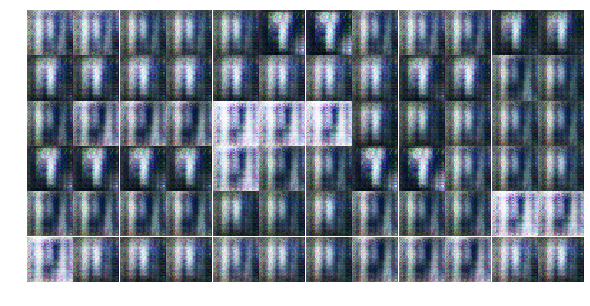

Epoch 1/100... Dloss: -0.4532 Gloss: -1.1957
Epoch 1/100... Dloss: -4.9480 Gloss: 0.1555
Epoch 1/100... Dloss: 0.0876 Gloss: -3.9155
Epoch 1/100... Dloss: -7.1621 Gloss: 5.0553
Epoch 1/100... Dloss: -8.3051 Gloss: 7.6091
Epoch 1/100... Dloss: -6.1038 Gloss: 0.8314
Epoch 1/100... Dloss: -5.7488 Gloss: 2.0023
Epoch 1/100... Dloss: -6.9711 Gloss: 1.4317
Epoch 1/100... Dloss: -20.4987 Gloss: 14.8061
Epoch 1/100... Dloss: -1.9509 Gloss: 4.7801


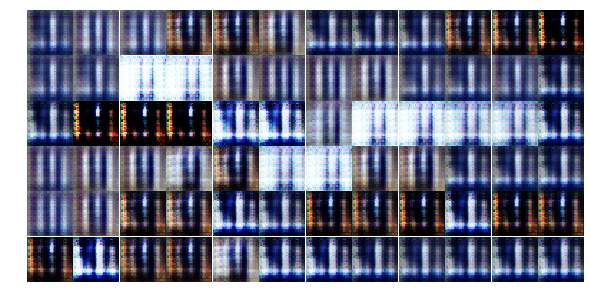

Epoch 1/100... Dloss: -4.4796 Gloss: 1.2425
Epoch 1/100... Dloss: -11.9445 Gloss: 13.3156
Epoch 1/100... Dloss: -16.3018 Gloss: 12.5091
Epoch 1/100... Dloss: -9.4662 Gloss: 8.5941
Epoch 1/100... Dloss: -23.5439 Gloss: 26.5123
Epoch 1/100... Dloss: -23.5669 Gloss: 23.1843
Epoch 1/100... Dloss: 0.0125 Gloss: 3.3133
Epoch 1/100... Dloss: -16.8235 Gloss: 7.3317
Epoch 1/100... Dloss: -13.0493 Gloss: 9.0031
Epoch 1/100... Dloss: -14.2604 Gloss: 9.8002


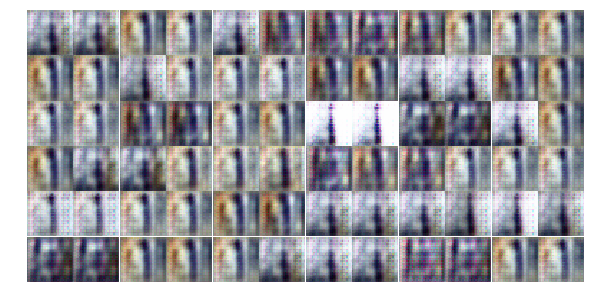

Epoch 1/100... Dloss: 2.5348 Gloss: -6.5720
Epoch 1/100... Dloss: 2.0518 Gloss: -15.5074
Epoch 1/100... Dloss: -8.0320 Gloss: -15.4046
Epoch 1/100... Dloss: -7.9798 Gloss: -1.8170
Epoch 1/100... Dloss: -24.3930 Gloss: 21.8576
Epoch 1/100... Dloss: -5.4687 Gloss: 25.3025
Epoch 1/100... Dloss: 4.9536 Gloss: 4.3036
Epoch 1/100... Dloss: -1.1215 Gloss: -13.1043
Epoch 1/100... Dloss: -2.2093 Gloss: 2.9707
Epoch 1/100... Dloss: -10.2380 Gloss: -10.4112


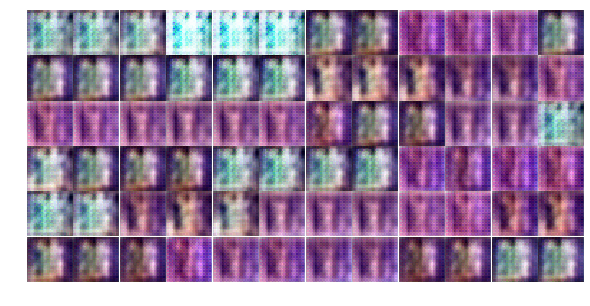

Epoch 1/100... Dloss: 3.2090 Gloss: -27.2350
Epoch 1/100... Dloss: 2.8396 Gloss: -17.4048
Epoch 1/100... Dloss: 1.8130 Gloss: -16.3099
Epoch 1/100... Dloss: 4.7875 Gloss: -35.9632
Epoch 1/100... Dloss: 1.2975 Gloss: -27.1369
Epoch 1/100... Dloss: -4.5081 Gloss: -15.8833
Epoch 1/100... Dloss: 2.3214 Gloss: -10.1670
Epoch 1/100... Dloss: -8.5279 Gloss: -2.9080
Epoch 1/100... Dloss: -0.7571 Gloss: -4.1415
Epoch 1/100... Dloss: -11.6464 Gloss: 0.9437


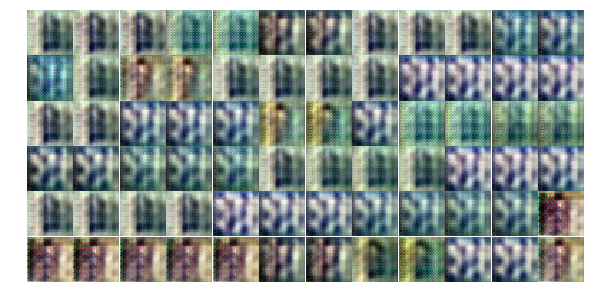

Epoch 1/100... Dloss: -0.6699 Gloss: -13.4419
Epoch 1/100... Dloss: 3.4738 Gloss: -13.6333
Epoch 1/100... Dloss: -6.9231 Gloss: -10.2121
Epoch 1/100... Dloss: 1.5107 Gloss: -6.0125
Epoch 1/100... Dloss: -1.9726 Gloss: -6.4443
Epoch 1/100... Dloss: -2.2609 Gloss: -5.5958
Epoch 1/100... Dloss: -1.7797 Gloss: 0.5291
Epoch 2/100... Dloss: -1.4884 Gloss: 0.5613
Epoch 2/100... Dloss: -2.2092 Gloss: 0.2637
Epoch 2/100... Dloss: 5.4365 Gloss: -10.9556


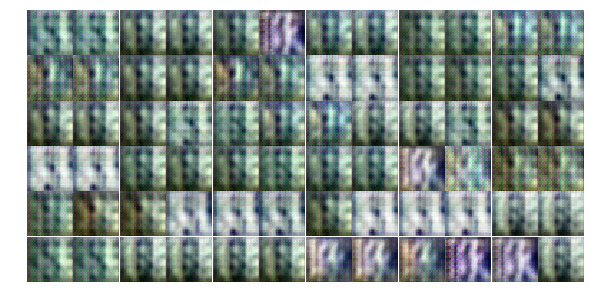

Epoch 2/100... Dloss: -8.0414 Gloss: 0.6970
Epoch 2/100... Dloss: 2.5856 Gloss: -9.2702
Epoch 2/100... Dloss: -2.2586 Gloss: -0.8650
Epoch 2/100... Dloss: -6.4222 Gloss: 3.6603
Epoch 2/100... Dloss: -2.6654 Gloss: -4.2687
Epoch 2/100... Dloss: -3.3691 Gloss: -2.3069
Epoch 2/100... Dloss: -10.8743 Gloss: 11.6810
Epoch 2/100... Dloss: 4.5755 Gloss: -0.5177
Epoch 2/100... Dloss: -0.9869 Gloss: 1.5825
Epoch 2/100... Dloss: 0.6193 Gloss: 3.3309


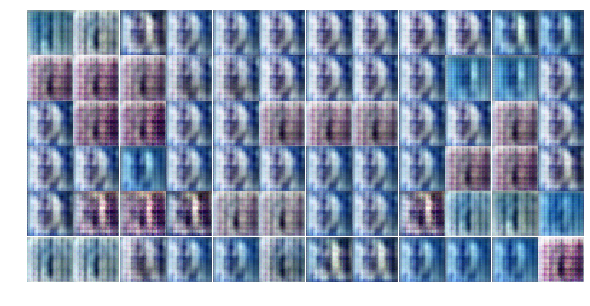

Epoch 2/100... Dloss: -5.5393 Gloss: 1.8197
Epoch 2/100... Dloss: -6.0346 Gloss: 5.8530
Epoch 2/100... Dloss: 3.2477 Gloss: -3.4534
Epoch 2/100... Dloss: -2.6018 Gloss: 0.7702
Epoch 2/100... Dloss: -9.7774 Gloss: 5.5108
Epoch 2/100... Dloss: -2.5687 Gloss: 2.8161
Epoch 2/100... Dloss: -5.4968 Gloss: -3.7613
Epoch 2/100... Dloss: -5.4893 Gloss: 10.7619
Epoch 2/100... Dloss: 5.7168 Gloss: -9.3389
Epoch 2/100... Dloss: -6.3924 Gloss: -1.7304


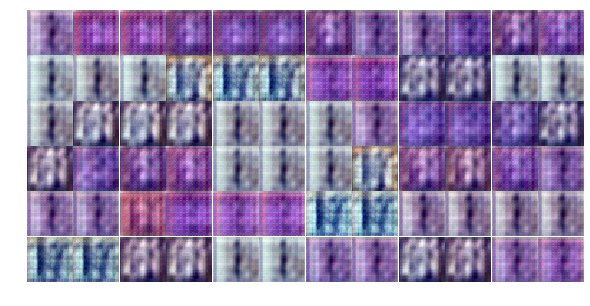

Epoch 2/100... Dloss: -10.2041 Gloss: -2.1924
Epoch 2/100... Dloss: -4.4172 Gloss: 3.3677
Epoch 2/100... Dloss: -8.6586 Gloss: 3.9171
Epoch 2/100... Dloss: 2.8550 Gloss: -14.3798
Epoch 2/100... Dloss: -8.4040 Gloss: -2.0035
Epoch 2/100... Dloss: 0.2377 Gloss: -0.2057
Epoch 2/100... Dloss: -6.1914 Gloss: -3.5543
Epoch 2/100... Dloss: 0.5384 Gloss: -6.5935
Epoch 2/100... Dloss: -9.8025 Gloss: 12.3793
Epoch 2/100... Dloss: -8.6779 Gloss: 8.0706


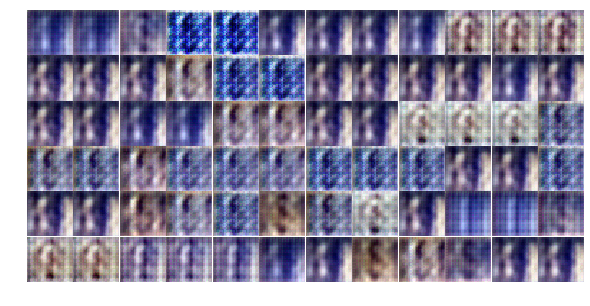

Epoch 2/100... Dloss: -1.7797 Gloss: -8.5361
Epoch 2/100... Dloss: -19.7417 Gloss: 15.4840
Epoch 2/100... Dloss: -16.0686 Gloss: 8.1091
Epoch 2/100... Dloss: 0.4103 Gloss: 6.7126
Epoch 2/100... Dloss: -22.0981 Gloss: 24.9766
Epoch 2/100... Dloss: -11.5688 Gloss: 1.8502
Epoch 2/100... Dloss: -11.8566 Gloss: 9.1440
Epoch 2/100... Dloss: 2.8673 Gloss: 3.9773
Epoch 2/100... Dloss: -14.9985 Gloss: 5.0446
Epoch 2/100... Dloss: 2.4438 Gloss: 15.4809


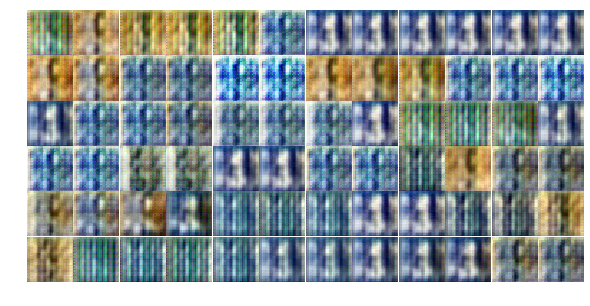

Epoch 2/100... Dloss: -5.8265 Gloss: 15.5320
Epoch 2/100... Dloss: -8.4560 Gloss: 15.8188
Epoch 2/100... Dloss: -8.5237 Gloss: 15.5817
Epoch 2/100... Dloss: -12.5346 Gloss: 17.8641
Epoch 2/100... Dloss: -6.2514 Gloss: 1.0693
Epoch 2/100... Dloss: -5.9891 Gloss: 14.9957
Epoch 2/100... Dloss: 2.1489 Gloss: 10.3805
Epoch 2/100... Dloss: -1.7338 Gloss: 7.7298
Epoch 2/100... Dloss: 6.7215 Gloss: -1.2960
Epoch 2/100... Dloss: -13.3765 Gloss: 11.6645


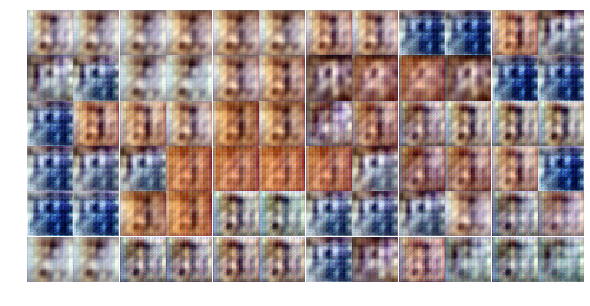

Epoch 2/100... Dloss: -11.5184 Gloss: 10.8986
Epoch 2/100... Dloss: -3.2000 Gloss: 6.5517
Epoch 2/100... Dloss: -4.9245 Gloss: 13.7156
Epoch 2/100... Dloss: 15.8176 Gloss: 0.2372
Epoch 3/100... Dloss: -4.7675 Gloss: 9.8894
Epoch 3/100... Dloss: 0.1212 Gloss: 9.0519
Epoch 3/100... Dloss: -4.3423 Gloss: 3.3493
Epoch 3/100... Dloss: -2.1689 Gloss: 8.9113
Epoch 3/100... Dloss: -5.2726 Gloss: 8.8287
Epoch 3/100... Dloss: -1.5860 Gloss: 4.0573


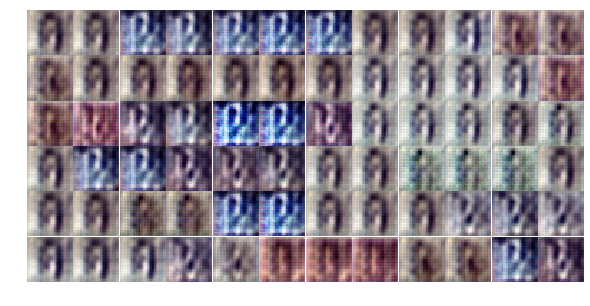

Epoch 3/100... Dloss: -7.4291 Gloss: 7.0329
Epoch 3/100... Dloss: -7.5154 Gloss: 18.1343
Epoch 3/100... Dloss: -16.5076 Gloss: 17.2566
Epoch 3/100... Dloss: -3.3152 Gloss: 18.4360
Epoch 3/100... Dloss: -14.5081 Gloss: 16.3878
Epoch 3/100... Dloss: 6.1585 Gloss: 15.8352
Epoch 3/100... Dloss: -2.3522 Gloss: 1.5403
Epoch 3/100... Dloss: 4.1617 Gloss: -3.6670
Epoch 3/100... Dloss: -7.1293 Gloss: -2.2381
Epoch 3/100... Dloss: -3.5301 Gloss: 4.8395


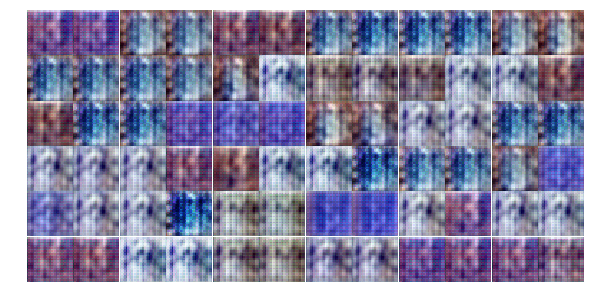

Epoch 3/100... Dloss: -5.2863 Gloss: 16.2367
Epoch 3/100... Dloss: -5.9306 Gloss: 9.1514
Epoch 3/100... Dloss: -11.6015 Gloss: 6.1596
Epoch 3/100... Dloss: -0.5097 Gloss: 3.9580
Epoch 3/100... Dloss: -15.6882 Gloss: 26.9721
Epoch 3/100... Dloss: -3.8757 Gloss: 16.1142
Epoch 3/100... Dloss: -2.8431 Gloss: 19.8393
Epoch 3/100... Dloss: -7.6639 Gloss: 4.6330
Epoch 3/100... Dloss: -16.1732 Gloss: 21.2118
Epoch 3/100... Dloss: -15.4160 Gloss: 33.1563


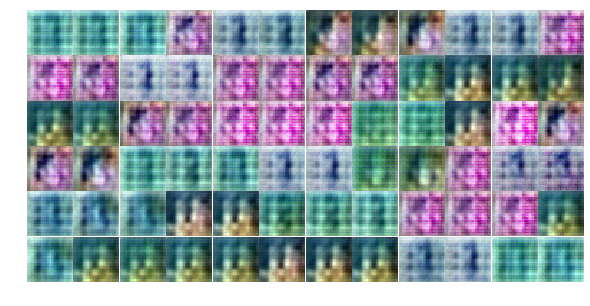

Epoch 3/100... Dloss: -0.8791 Gloss: 19.4380
Epoch 3/100... Dloss: -2.4531 Gloss: 23.5204
Epoch 3/100... Dloss: -21.1852 Gloss: 9.7673
Epoch 3/100... Dloss: -26.8407 Gloss: 16.3791
Epoch 3/100... Dloss: -13.2176 Gloss: 29.9649
Epoch 3/100... Dloss: -12.5478 Gloss: -2.2464
Epoch 3/100... Dloss: -8.4731 Gloss: 3.3308
Epoch 3/100... Dloss: 4.6011 Gloss: -14.2498
Epoch 3/100... Dloss: -12.8273 Gloss: -2.8613
Epoch 3/100... Dloss: 4.7206 Gloss: -3.0050


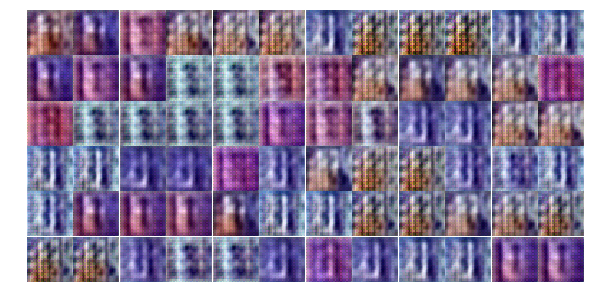

Epoch 3/100... Dloss: -17.7902 Gloss: 6.5812
Epoch 3/100... Dloss: -1.7209 Gloss: 16.8016
Epoch 3/100... Dloss: -16.9825 Gloss: 29.1156
Epoch 3/100... Dloss: 2.7920 Gloss: -1.5128
Epoch 3/100... Dloss: -0.5797 Gloss: -0.2537
Epoch 3/100... Dloss: 2.7763 Gloss: 2.5998
Epoch 3/100... Dloss: -10.5376 Gloss: 1.2711
Epoch 3/100... Dloss: -31.9360 Gloss: 13.5680
Epoch 3/100... Dloss: -7.0404 Gloss: 8.4141
Epoch 3/100... Dloss: -11.6487 Gloss: 17.9820


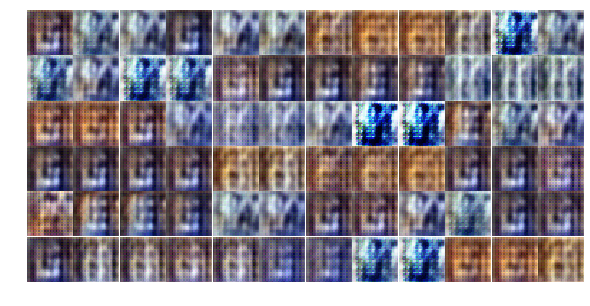

Epoch 3/100... Dloss: 5.0288 Gloss: -10.3172
Epoch 3/100... Dloss: -15.0904 Gloss: 15.4100
Epoch 3/100... Dloss: 2.1377 Gloss: 7.4441
Epoch 3/100... Dloss: -11.9024 Gloss: 0.2787
Epoch 3/100... Dloss: -4.7814 Gloss: -21.0484
Epoch 3/100... Dloss: 11.4744 Gloss: -19.8696
Epoch 3/100... Dloss: -15.2805 Gloss: 4.6071
Epoch 3/100... Dloss: -4.7029 Gloss: 1.7000
Epoch 3/100... Dloss: 1.8370 Gloss: 6.1480
Epoch 3/100... Dloss: 4.1807 Gloss: -17.9766


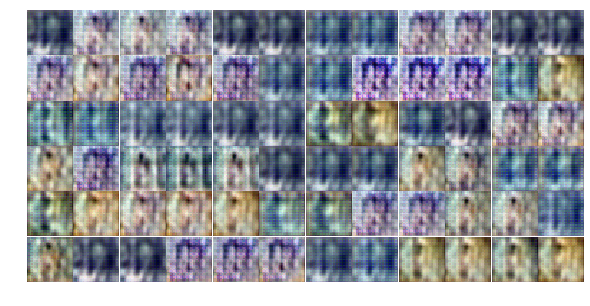

Epoch 3/100... Dloss: 0.3770 Gloss: 7.5619
Epoch 4/100... Dloss: -2.3131 Gloss: 3.0358
Epoch 4/100... Dloss: -5.1382 Gloss: 8.9613
Epoch 4/100... Dloss: -0.4930 Gloss: -4.9055
Epoch 4/100... Dloss: -9.8213 Gloss: 2.3497
Epoch 4/100... Dloss: -1.7331 Gloss: -1.2651
Epoch 4/100... Dloss: -15.0767 Gloss: 5.4107
Epoch 4/100... Dloss: 3.4817 Gloss: -9.5825
Epoch 4/100... Dloss: -11.3019 Gloss: 3.2012
Epoch 4/100... Dloss: 7.6722 Gloss: -11.6916


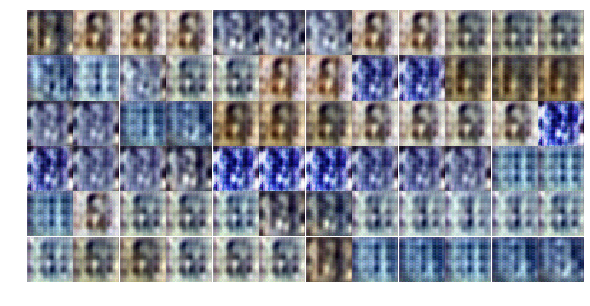

Epoch 4/100... Dloss: 9.8555 Gloss: -25.6435
Epoch 4/100... Dloss: -7.5625 Gloss: 7.0560
Epoch 4/100... Dloss: -0.4460 Gloss: 0.3386
Epoch 4/100... Dloss: -2.4188 Gloss: -1.7195
Epoch 4/100... Dloss: -9.4882 Gloss: 1.9484
Epoch 4/100... Dloss: -0.7354 Gloss: -8.2302
Epoch 4/100... Dloss: -17.9940 Gloss: 9.3502
Epoch 4/100... Dloss: -1.9253 Gloss: 2.8398
Epoch 4/100... Dloss: -18.6341 Gloss: 7.0879
Epoch 4/100... Dloss: -29.0962 Gloss: 12.7710


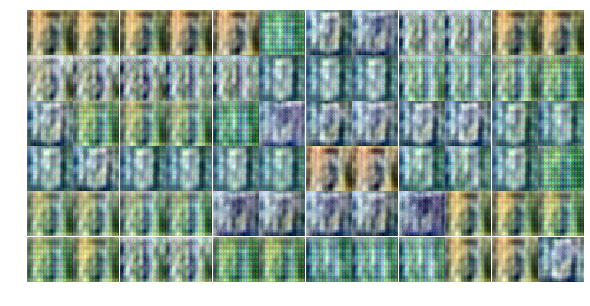

Epoch 4/100... Dloss: -8.6822 Gloss: -0.6102
Epoch 4/100... Dloss: -7.0371 Gloss: 30.8432
Epoch 4/100... Dloss: -13.9506 Gloss: 35.8274
Epoch 4/100... Dloss: -10.5424 Gloss: 13.2305
Epoch 4/100... Dloss: -10.7248 Gloss: 12.9359
Epoch 4/100... Dloss: -17.5876 Gloss: 12.9426
Epoch 4/100... Dloss: -29.5527 Gloss: 21.4178
Epoch 4/100... Dloss: -34.6313 Gloss: 42.7725
Epoch 4/100... Dloss: 15.4931 Gloss: 20.5819
Epoch 4/100... Dloss: -14.3389 Gloss: 26.8498


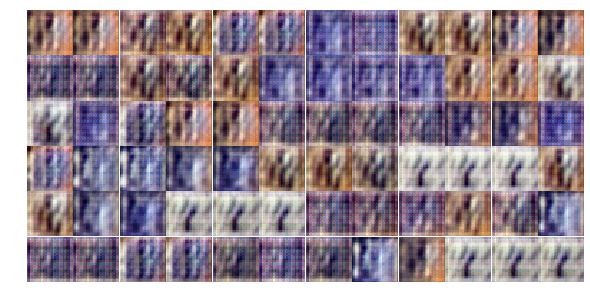

Epoch 4/100... Dloss: 0.7758 Gloss: 34.1456
Epoch 4/100... Dloss: -3.6221 Gloss: 6.6459
Epoch 4/100... Dloss: -14.9226 Gloss: 17.0604
Epoch 4/100... Dloss: -1.1982 Gloss: -21.7209
Epoch 4/100... Dloss: -13.3052 Gloss: -1.9997
Epoch 4/100... Dloss: 1.4254 Gloss: 13.2576
Epoch 4/100... Dloss: -17.5350 Gloss: 28.5632
Epoch 4/100... Dloss: 21.2956 Gloss: 1.7885
Epoch 4/100... Dloss: -6.7791 Gloss: 5.7801
Epoch 4/100... Dloss: -16.2767 Gloss: 19.3127


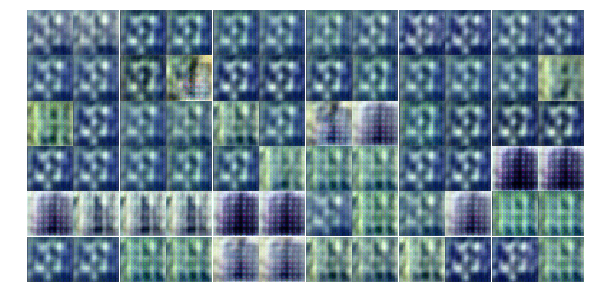

Epoch 4/100... Dloss: -13.9829 Gloss: 13.1618
Epoch 4/100... Dloss: -2.4492 Gloss: -9.5402
Epoch 4/100... Dloss: 4.9678 Gloss: -7.7782
Epoch 4/100... Dloss: -6.3785 Gloss: -1.2619
Epoch 4/100... Dloss: -23.5337 Gloss: 2.9647
Epoch 4/100... Dloss: 1.9074 Gloss: -5.0735
Epoch 4/100... Dloss: -26.5922 Gloss: 33.1312
Epoch 4/100... Dloss: -29.7281 Gloss: 34.1007
Epoch 4/100... Dloss: 12.2849 Gloss: -13.6246
Epoch 4/100... Dloss: -38.8796 Gloss: 20.9262


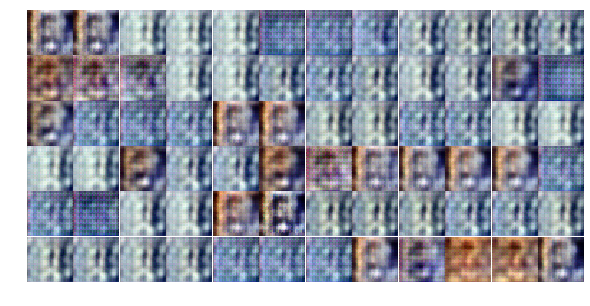

Epoch 4/100... Dloss: -9.3732 Gloss: -7.0584
Epoch 4/100... Dloss: -8.3214 Gloss: 1.2090
Epoch 4/100... Dloss: -6.5820 Gloss: 26.1558
Epoch 4/100... Dloss: 12.7530 Gloss: 18.4072
Epoch 4/100... Dloss: -3.9157 Gloss: 5.9148
Epoch 4/100... Dloss: -14.6764 Gloss: 8.5603
Epoch 4/100... Dloss: -14.0961 Gloss: 20.2055
Epoch 4/100... Dloss: 2.2323 Gloss: -8.2348
Epoch 4/100... Dloss: -3.2237 Gloss: 4.6239
Epoch 5/100... Dloss: 7.7993 Gloss: -27.9607


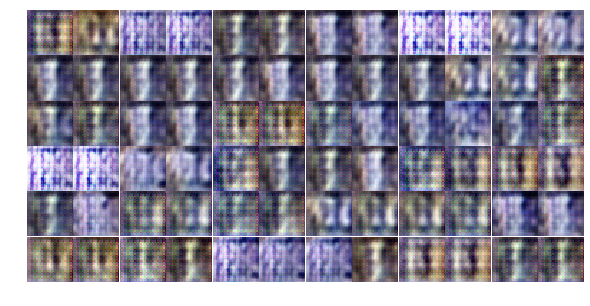

Epoch 5/100... Dloss: -2.2956 Gloss: -12.0459
Epoch 5/100... Dloss: -0.2858 Gloss: -0.2612
Epoch 5/100... Dloss: -7.7501 Gloss: 7.3411
Epoch 5/100... Dloss: -8.6135 Gloss: 13.2648
Epoch 5/100... Dloss: -2.3952 Gloss: 7.5753
Epoch 5/100... Dloss: -14.2800 Gloss: 11.9673
Epoch 5/100... Dloss: 0.3647 Gloss: -5.1525
Epoch 5/100... Dloss: -2.1462 Gloss: -9.6535
Epoch 5/100... Dloss: 0.5978 Gloss: -10.8688
Epoch 5/100... Dloss: -18.4410 Gloss: 6.1100


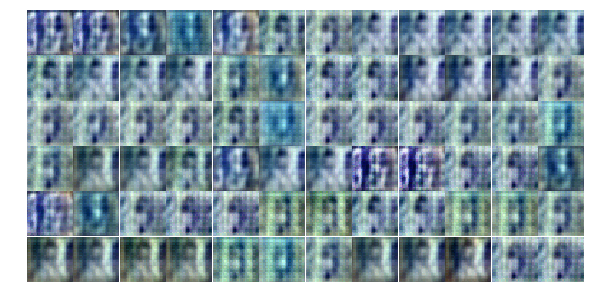

Epoch 5/100... Dloss: -0.7385 Gloss: 17.8128
Epoch 5/100... Dloss: -0.0235 Gloss: -7.1063
Epoch 5/100... Dloss: -1.6112 Gloss: -11.0186
Epoch 5/100... Dloss: -11.3260 Gloss: 5.0197
Epoch 5/100... Dloss: -2.1855 Gloss: 7.8823
Epoch 5/100... Dloss: 6.4420 Gloss: -6.1966
Epoch 5/100... Dloss: -3.4093 Gloss: -6.1840
Epoch 5/100... Dloss: -6.3730 Gloss: -7.9305
Epoch 5/100... Dloss: -8.6346 Gloss: -1.2473
Epoch 5/100... Dloss: 2.6246 Gloss: -2.5383


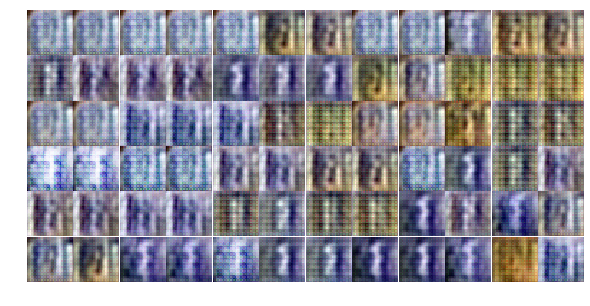

Epoch 5/100... Dloss: -10.1296 Gloss: 9.8941
Epoch 5/100... Dloss: 2.0090 Gloss: -5.8186
Epoch 5/100... Dloss: -4.1415 Gloss: 1.4711
Epoch 5/100... Dloss: -16.6990 Gloss: 17.2858
Epoch 5/100... Dloss: 5.8128 Gloss: -0.0496
Epoch 5/100... Dloss: -6.8249 Gloss: 1.9604
Epoch 5/100... Dloss: 7.1146 Gloss: -15.9493
Epoch 5/100... Dloss: -3.5565 Gloss: 2.8420
Epoch 5/100... Dloss: -3.0326 Gloss: 5.4963
Epoch 5/100... Dloss: -4.6086 Gloss: 5.1972


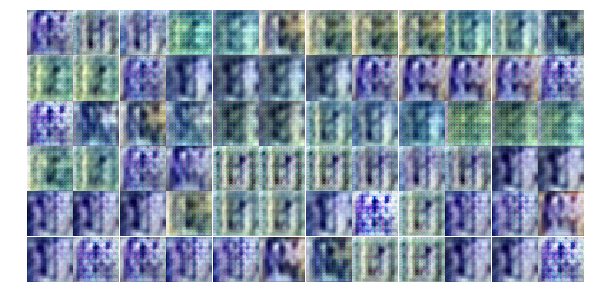

Epoch 5/100... Dloss: 2.8955 Gloss: -1.9244
Epoch 5/100... Dloss: -15.2739 Gloss: 11.4966
Epoch 5/100... Dloss: 10.5130 Gloss: -14.2185
Epoch 5/100... Dloss: -2.4086 Gloss: -6.3061
Epoch 5/100... Dloss: 5.5796 Gloss: 32.0702
Epoch 5/100... Dloss: -9.5365 Gloss: 22.5580
Epoch 5/100... Dloss: -6.1355 Gloss: 16.9209
Epoch 5/100... Dloss: 5.9420 Gloss: -11.4869
Epoch 5/100... Dloss: -16.7392 Gloss: 8.3172
Epoch 5/100... Dloss: -11.5538 Gloss: 17.6526


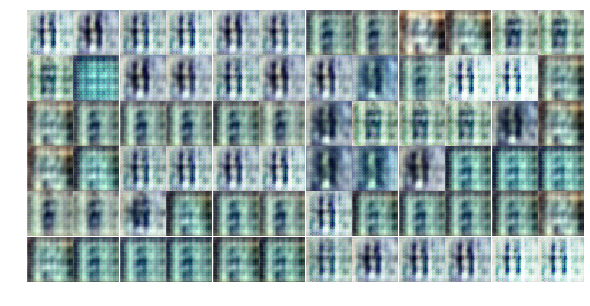

Epoch 5/100... Dloss: -7.9557 Gloss: 5.0508
Epoch 5/100... Dloss: -9.5863 Gloss: 16.5279
Epoch 5/100... Dloss: -11.4584 Gloss: 12.3191
Epoch 5/100... Dloss: -6.1130 Gloss: 32.0917
Epoch 5/100... Dloss: 4.8797 Gloss: 16.7569
Epoch 5/100... Dloss: -4.2216 Gloss: -5.6950
Epoch 5/100... Dloss: -6.9862 Gloss: 10.7055
Epoch 5/100... Dloss: -16.1219 Gloss: 16.7526
Epoch 5/100... Dloss: -25.1414 Gloss: 15.3573
Epoch 5/100... Dloss: 1.9075 Gloss: 2.2072


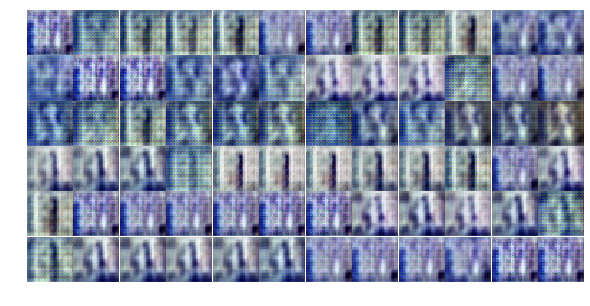

Epoch 5/100... Dloss: -3.3951 Gloss: 13.8072
Epoch 5/100... Dloss: -7.1665 Gloss: 28.2451
Epoch 5/100... Dloss: -13.9885 Gloss: 30.8794
Epoch 5/100... Dloss: -20.5593 Gloss: 23.5402
Epoch 5/100... Dloss: -4.4830 Gloss: 7.2997
Epoch 5/100... Dloss: -9.4848 Gloss: 0.6553
Epoch 6/100... Dloss: -9.1762 Gloss: 7.6304
Epoch 6/100... Dloss: 0.2722 Gloss: 6.9025
Epoch 6/100... Dloss: -10.5841 Gloss: 14.9976
Epoch 6/100... Dloss: -7.7103 Gloss: 4.3339


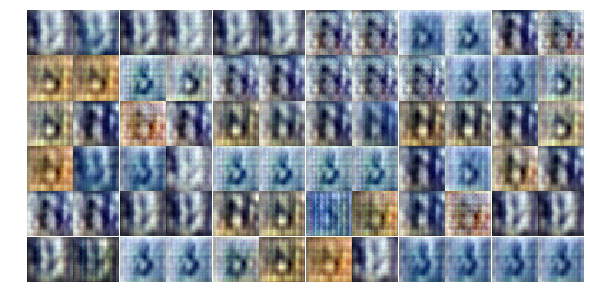

Epoch 6/100... Dloss: -2.8133 Gloss: -0.5372
Epoch 6/100... Dloss: -1.3309 Gloss: 0.0272
Epoch 6/100... Dloss: -7.0837 Gloss: 8.4990
Epoch 6/100... Dloss: -16.8344 Gloss: 12.8036
Epoch 6/100... Dloss: -28.8682 Gloss: 30.3856
Epoch 6/100... Dloss: -15.6077 Gloss: 11.6238
Epoch 6/100... Dloss: 11.9395 Gloss: -7.3265
Epoch 6/100... Dloss: -19.1754 Gloss: 12.8903
Epoch 6/100... Dloss: -2.7102 Gloss: 4.7733
Epoch 6/100... Dloss: -18.1309 Gloss: 11.3803


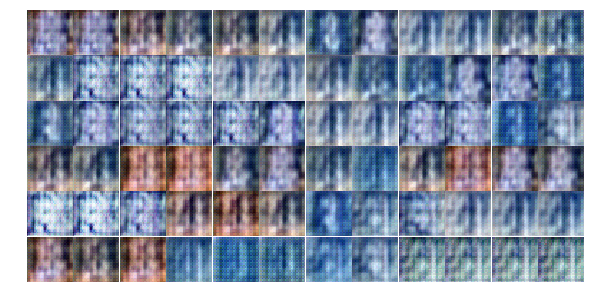

Epoch 6/100... Dloss: -16.1586 Gloss: 40.2070
Epoch 6/100... Dloss: -10.9412 Gloss: 27.1618
Epoch 6/100... Dloss: -30.5920 Gloss: 26.8672
Epoch 6/100... Dloss: -35.8571 Gloss: 39.1182
Epoch 6/100... Dloss: 7.0261 Gloss: -17.5580
Epoch 6/100... Dloss: 0.6912 Gloss: 13.4666
Epoch 6/100... Dloss: -10.6894 Gloss: 23.6572
Epoch 6/100... Dloss: -22.5440 Gloss: 12.9474
Epoch 6/100... Dloss: -1.3213 Gloss: 0.7088
Epoch 6/100... Dloss: -27.6718 Gloss: 11.1140


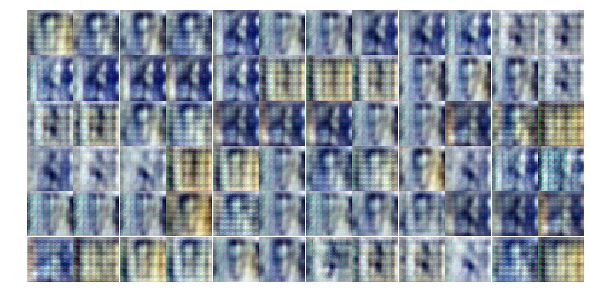

Epoch 6/100... Dloss: -16.8150 Gloss: 0.7461
Epoch 6/100... Dloss: -14.7617 Gloss: 14.1773
Epoch 6/100... Dloss: -38.9008 Gloss: 28.8101
Epoch 6/100... Dloss: -43.1709 Gloss: 25.6669
Epoch 6/100... Dloss: -11.3247 Gloss: 36.6577
Epoch 6/100... Dloss: 0.9241 Gloss: 24.7877
Epoch 6/100... Dloss: -0.6186 Gloss: 16.1401
Epoch 6/100... Dloss: -10.4605 Gloss: 31.9822
Epoch 6/100... Dloss: 0.1667 Gloss: 10.8495
Epoch 6/100... Dloss: -3.2331 Gloss: 10.8381


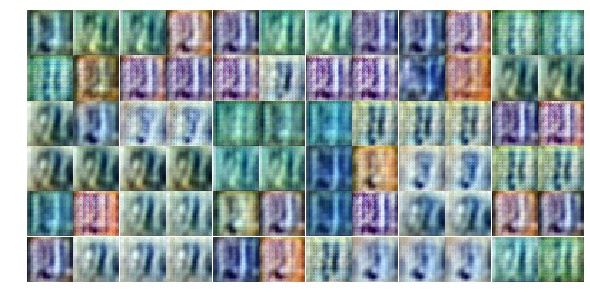

Epoch 6/100... Dloss: -9.2021 Gloss: 11.5995
Epoch 6/100... Dloss: -20.2489 Gloss: 28.6184
Epoch 6/100... Dloss: 11.0227 Gloss: -15.4904
Epoch 6/100... Dloss: -0.2898 Gloss: 9.2902
Epoch 6/100... Dloss: -44.7397 Gloss: 59.5422
Epoch 6/100... Dloss: 11.4827 Gloss: 32.4742
Epoch 6/100... Dloss: -12.6503 Gloss: 30.9409
Epoch 6/100... Dloss: -18.8091 Gloss: 5.0683
Epoch 6/100... Dloss: -25.1575 Gloss: 22.7186
Epoch 6/100... Dloss: -19.5604 Gloss: 26.1405


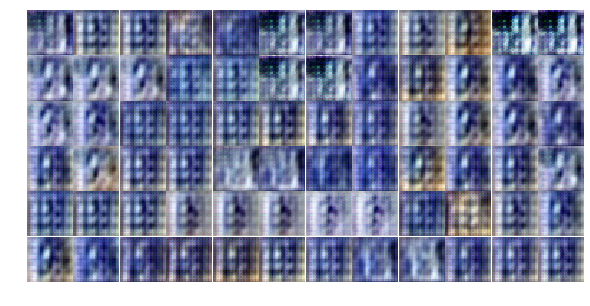

Epoch 6/100... Dloss: -18.4703 Gloss: 5.5513
Epoch 6/100... Dloss: -44.2856 Gloss: 39.2075
Epoch 6/100... Dloss: -18.6512 Gloss: -9.7576
Epoch 6/100... Dloss: -36.5410 Gloss: 51.0985
Epoch 6/100... Dloss: 13.5502 Gloss: -15.4687
Epoch 6/100... Dloss: -3.4400 Gloss: 8.6986
Epoch 6/100... Dloss: -15.8362 Gloss: -3.7702
Epoch 6/100... Dloss: -22.2219 Gloss: 15.9794
Epoch 6/100... Dloss: -51.1116 Gloss: 45.4209
Epoch 6/100... Dloss: -0.1067 Gloss: 6.6412


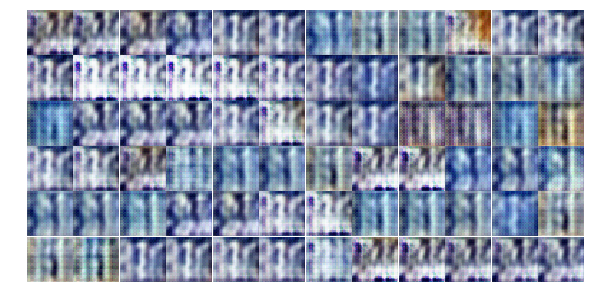

Epoch 6/100... Dloss: -13.2214 Gloss: -30.4085
Epoch 6/100... Dloss: -16.1269 Gloss: -7.4482
Epoch 6/100... Dloss: -14.0121 Gloss: 7.4340
Epoch 7/100... Dloss: 12.7900 Gloss: -33.7820
Epoch 7/100... Dloss: 7.2655 Gloss: -28.2277
Epoch 7/100... Dloss: -23.2633 Gloss: 7.0027
Epoch 7/100... Dloss: 9.1289 Gloss: -32.1671
Epoch 7/100... Dloss: -19.1275 Gloss: -9.0972
Epoch 7/100... Dloss: -18.4489 Gloss: 21.0482
Epoch 7/100... Dloss: -25.3704 Gloss: 5.0177


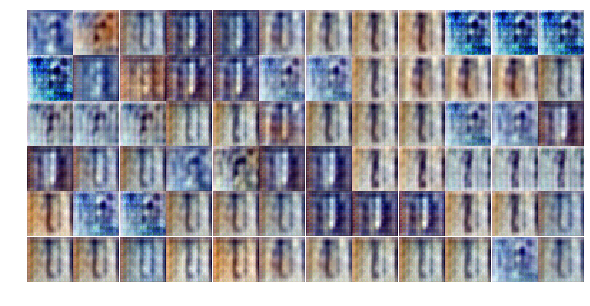

Epoch 7/100... Dloss: -24.1394 Gloss: -0.8289
Epoch 7/100... Dloss: -5.0345 Gloss: 9.5802
Epoch 7/100... Dloss: -25.9012 Gloss: 5.2220
Epoch 7/100... Dloss: -63.7836 Gloss: 35.8961
Epoch 7/100... Dloss: -12.1813 Gloss: 38.1700
Epoch 7/100... Dloss: -17.5406 Gloss: -20.8174
Epoch 7/100... Dloss: 2.4277 Gloss: -12.9403
Epoch 7/100... Dloss: -14.2410 Gloss: -7.1025
Epoch 7/100... Dloss: 0.3770 Gloss: -0.1440
Epoch 7/100... Dloss: -3.7316 Gloss: 36.0372


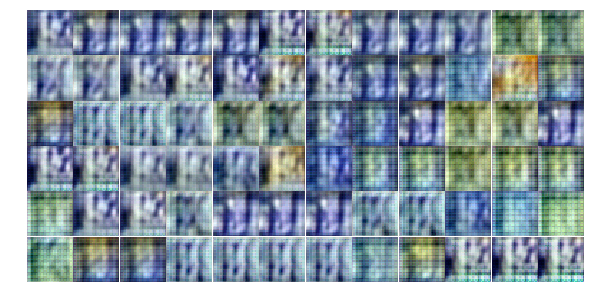

Epoch 7/100... Dloss: -1.8979 Gloss: 26.2783
Epoch 7/100... Dloss: -7.1559 Gloss: 3.3728
Epoch 7/100... Dloss: 6.4485 Gloss: 17.6381
Epoch 7/100... Dloss: -33.1670 Gloss: 48.4237
Epoch 7/100... Dloss: 6.1453 Gloss: 10.7357
Epoch 7/100... Dloss: -11.5266 Gloss: 14.1494
Epoch 7/100... Dloss: -13.1434 Gloss: 32.8889
Epoch 7/100... Dloss: 6.8010 Gloss: 24.1982
Epoch 7/100... Dloss: -25.2519 Gloss: 35.2157
Epoch 7/100... Dloss: 9.9735 Gloss: -17.2615


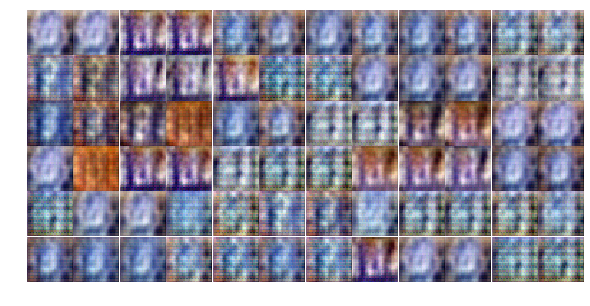

Epoch 7/100... Dloss: -13.5095 Gloss: -2.9804
Epoch 7/100... Dloss: -10.0796 Gloss: 13.6031
Epoch 7/100... Dloss: -15.1122 Gloss: 19.6863
Epoch 7/100... Dloss: -2.5628 Gloss: 6.9354
Epoch 7/100... Dloss: -20.6572 Gloss: 12.2926
Epoch 7/100... Dloss: -10.8152 Gloss: 11.9817
Epoch 7/100... Dloss: -10.3771 Gloss: 25.8764
Epoch 7/100... Dloss: -4.4701 Gloss: 7.4097
Epoch 7/100... Dloss: -1.0931 Gloss: 6.6428
Epoch 7/100... Dloss: 5.1457 Gloss: 5.6311


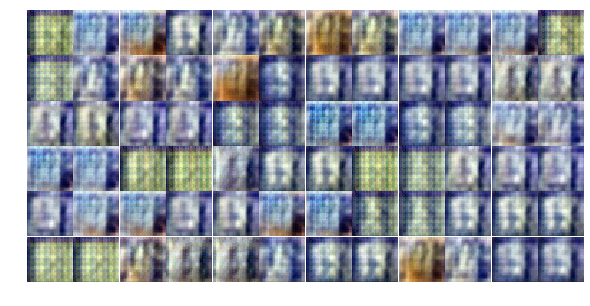

Epoch 7/100... Dloss: 0.8394 Gloss: 5.4741
Epoch 7/100... Dloss: -2.3404 Gloss: 19.1505
Epoch 7/100... Dloss: -7.7067 Gloss: 7.0355
Epoch 7/100... Dloss: -10.6679 Gloss: 9.8771
Epoch 7/100... Dloss: -2.6269 Gloss: -7.2146
Epoch 7/100... Dloss: -6.0649 Gloss: -6.8791
Epoch 7/100... Dloss: -12.0765 Gloss: 0.1541
Epoch 7/100... Dloss: -6.2571 Gloss: 0.1579
Epoch 7/100... Dloss: -10.2776 Gloss: 4.8785
Epoch 7/100... Dloss: -13.5910 Gloss: 32.5891


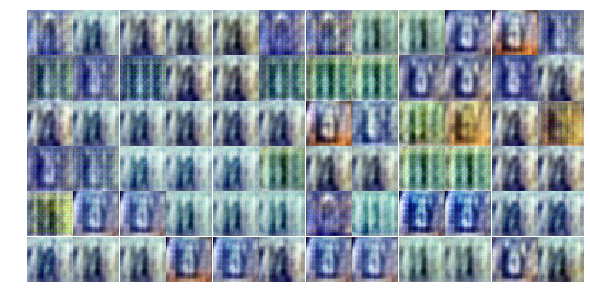

Epoch 7/100... Dloss: 5.7298 Gloss: 7.7565
Epoch 7/100... Dloss: -20.2964 Gloss: 25.0639
Epoch 7/100... Dloss: -10.3575 Gloss: 25.9748
Epoch 7/100... Dloss: 0.6798 Gloss: -0.7357
Epoch 7/100... Dloss: -8.9189 Gloss: 7.8301
Epoch 7/100... Dloss: 5.5263 Gloss: 1.9391
Epoch 7/100... Dloss: -15.3155 Gloss: 10.9018
Epoch 7/100... Dloss: 6.5431 Gloss: 7.2273
Epoch 7/100... Dloss: -2.4439 Gloss: -13.7887
Epoch 7/100... Dloss: 4.0149 Gloss: -2.9505


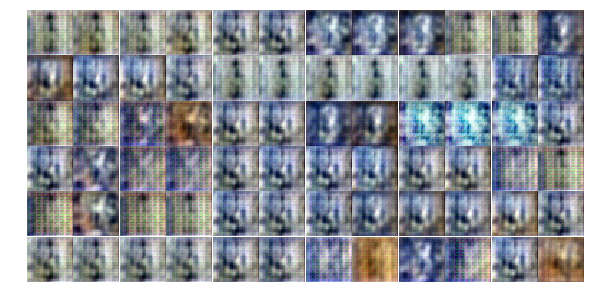

Epoch 7/100... Dloss: -16.7383 Gloss: 14.0631
Epoch 8/100... Dloss: -12.8139 Gloss: 5.6305
Epoch 8/100... Dloss: 1.1130 Gloss: -0.5156
Epoch 8/100... Dloss: -21.2050 Gloss: 15.4563
Epoch 8/100... Dloss: 5.8882 Gloss: 0.7341
Epoch 8/100... Dloss: -25.1792 Gloss: 37.1785
Epoch 8/100... Dloss: -23.2286 Gloss: 54.0435
Epoch 8/100... Dloss: -11.6536 Gloss: 36.9922
Epoch 8/100... Dloss: 8.7185 Gloss: 20.9938
Epoch 8/100... Dloss: -24.7846 Gloss: 36.8561


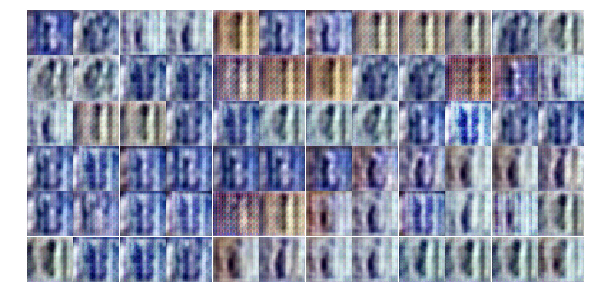

Epoch 8/100... Dloss: -37.0539 Gloss: 42.6803
Epoch 8/100... Dloss: -46.6118 Gloss: 25.4135
Epoch 8/100... Dloss: -45.7086 Gloss: 55.2817
Epoch 8/100... Dloss: -83.9645 Gloss: 58.4627
Epoch 8/100... Dloss: -13.3019 Gloss: 23.7559
Epoch 8/100... Dloss: -42.8535 Gloss: 26.3318
Epoch 8/100... Dloss: -16.0936 Gloss: 47.7667
Epoch 8/100... Dloss: -34.5686 Gloss: 50.7897
Epoch 8/100... Dloss: 14.2055 Gloss: 2.3061
Epoch 8/100... Dloss: -42.5406 Gloss: 12.5476


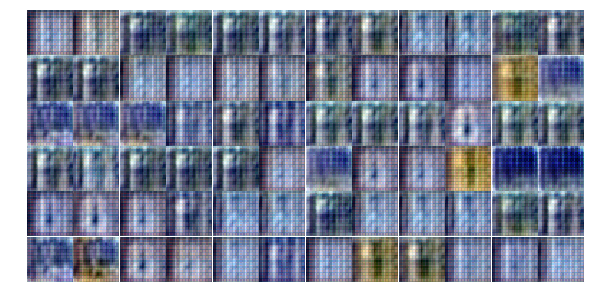

Epoch 8/100... Dloss: -27.1929 Gloss: 63.6373
Epoch 8/100... Dloss: -9.4572 Gloss: 38.9961
Epoch 8/100... Dloss: -28.9186 Gloss: 28.2365
Epoch 8/100... Dloss: -40.8274 Gloss: 21.6811
Epoch 8/100... Dloss: -33.9956 Gloss: 40.9726
Epoch 8/100... Dloss: 33.5553 Gloss: -22.0875
Epoch 8/100... Dloss: 10.7704 Gloss: -5.9612
Epoch 8/100... Dloss: -36.1145 Gloss: 22.2684
Epoch 8/100... Dloss: -6.8997 Gloss: 35.9869
Epoch 8/100... Dloss: -63.4958 Gloss: 63.9248


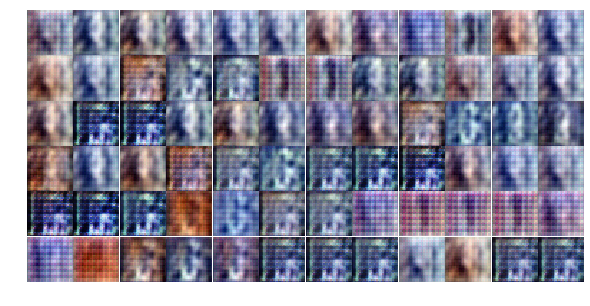

Epoch 8/100... Dloss: 0.3006 Gloss: 1.1886
Epoch 8/100... Dloss: -4.6618 Gloss: 11.8265
Epoch 8/100... Dloss: -33.2012 Gloss: 44.5915
Epoch 8/100... Dloss: -19.4430 Gloss: -1.2971
Epoch 8/100... Dloss: -59.3933 Gloss: 65.4181
Epoch 8/100... Dloss: -28.9816 Gloss: 79.4820
Epoch 8/100... Dloss: 4.0038 Gloss: 42.9759
Epoch 8/100... Dloss: -2.5434 Gloss: 24.7579
Epoch 8/100... Dloss: -3.4887 Gloss: 35.8806
Epoch 8/100... Dloss: -50.3394 Gloss: 32.6859


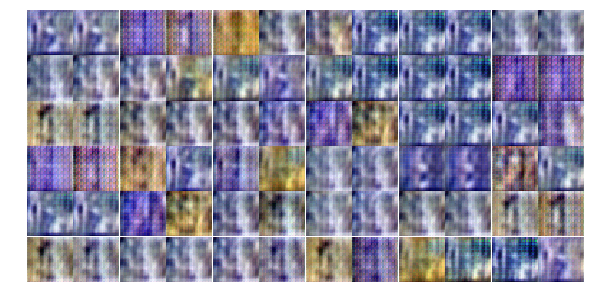

Epoch 8/100... Dloss: -51.3174 Gloss: 34.2743
Epoch 8/100... Dloss: -33.0785 Gloss: 14.8267
Epoch 8/100... Dloss: -52.1790 Gloss: 40.9685
Epoch 8/100... Dloss: -31.1583 Gloss: 53.4443
Epoch 8/100... Dloss: -5.7972 Gloss: -29.0471
Epoch 8/100... Dloss: 9.5611 Gloss: -33.6704
Epoch 8/100... Dloss: -15.1188 Gloss: 7.3439
Epoch 8/100... Dloss: -1.4573 Gloss: -3.0096
Epoch 8/100... Dloss: -9.3394 Gloss: 12.0632
Epoch 8/100... Dloss: -24.0546 Gloss: 29.6942


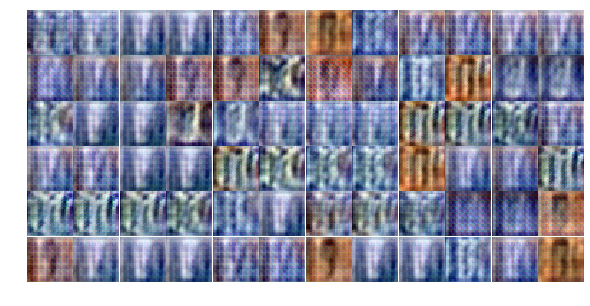

Epoch 8/100... Dloss: -7.4826 Gloss: 5.8663
Epoch 8/100... Dloss: 20.4903 Gloss: -28.4781
Epoch 8/100... Dloss: -5.3257 Gloss: 10.0041
Epoch 8/100... Dloss: -17.0343 Gloss: 42.1592
Epoch 8/100... Dloss: 9.6846 Gloss: 6.9484
Epoch 8/100... Dloss: -26.3811 Gloss: 19.4971
Epoch 8/100... Dloss: -17.9500 Gloss: -11.6498
Epoch 8/100... Dloss: -9.2648 Gloss: -1.8488
Epoch 9/100... Dloss: -19.6357 Gloss: 45.4717
Epoch 9/100... Dloss: -18.2645 Gloss: 32.4233


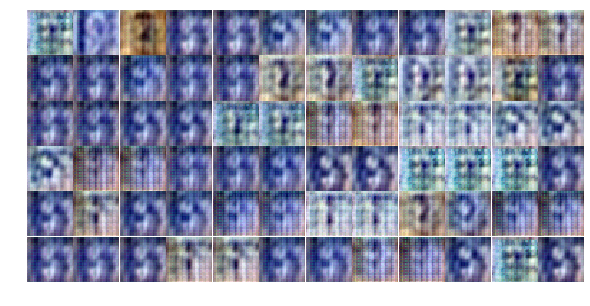

Epoch 9/100... Dloss: 2.3994 Gloss: -8.5104
Epoch 9/100... Dloss: -20.4055 Gloss: 17.9645
Epoch 9/100... Dloss: 22.5467 Gloss: -1.7266
Epoch 9/100... Dloss: -14.8295 Gloss: 15.0746
Epoch 9/100... Dloss: 7.2542 Gloss: -6.2320
Epoch 9/100... Dloss: -31.1201 Gloss: 13.4531
Epoch 9/100... Dloss: 7.3926 Gloss: -27.0831
Epoch 9/100... Dloss: -26.7949 Gloss: 28.4832
Epoch 9/100... Dloss: -7.8179 Gloss: 21.0827
Epoch 9/100... Dloss: 16.0196 Gloss: 15.2627


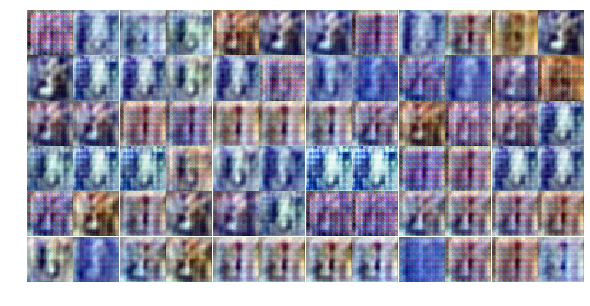

Epoch 9/100... Dloss: -20.9972 Gloss: 32.5393
Epoch 9/100... Dloss: -2.6646 Gloss: 20.9132
Epoch 9/100... Dloss: -20.7460 Gloss: 42.9882
Epoch 9/100... Dloss: -40.2530 Gloss: 58.1949
Epoch 9/100... Dloss: -13.6129 Gloss: 20.0417
Epoch 9/100... Dloss: 6.9825 Gloss: -15.4264
Epoch 9/100... Dloss: 7.7336 Gloss: -18.4619
Epoch 9/100... Dloss: -2.2392 Gloss: 33.1326
Epoch 9/100... Dloss: -25.9486 Gloss: 29.6542
Epoch 9/100... Dloss: 7.7237 Gloss: 9.7907


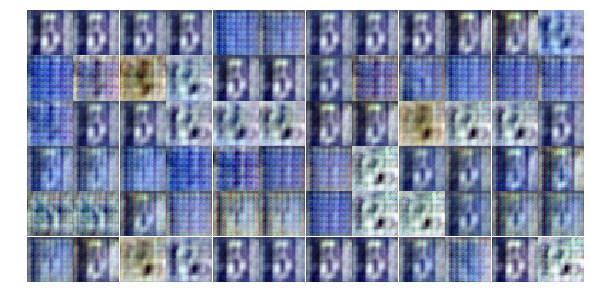

Epoch 9/100... Dloss: -35.7267 Gloss: 37.7413
Epoch 9/100... Dloss: 28.0509 Gloss: -24.9982
Epoch 9/100... Dloss: -42.7667 Gloss: 41.3955
Epoch 9/100... Dloss: 6.5447 Gloss: 26.5394
Epoch 9/100... Dloss: -46.1766 Gloss: 29.8192
Epoch 9/100... Dloss: -20.0741 Gloss: 4.7010
Epoch 9/100... Dloss: -23.0824 Gloss: 8.6987
Epoch 9/100... Dloss: -2.8195 Gloss: 33.5820
Epoch 9/100... Dloss: 12.0363 Gloss: -26.6122
Epoch 9/100... Dloss: -22.0398 Gloss: -10.1422


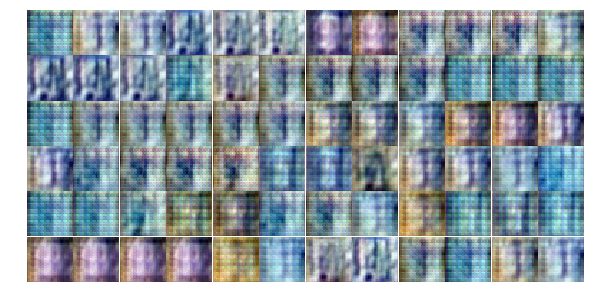

Epoch 9/100... Dloss: 1.7976 Gloss: 34.2379
Epoch 9/100... Dloss: -24.8773 Gloss: 39.8699
Epoch 9/100... Dloss: -31.1913 Gloss: 48.6725
Epoch 9/100... Dloss: 0.7919 Gloss: 9.8957
Epoch 9/100... Dloss: 1.0584 Gloss: -2.7233
Epoch 9/100... Dloss: -26.3382 Gloss: 80.8575
Epoch 9/100... Dloss: -21.2296 Gloss: 16.3282
Epoch 9/100... Dloss: -16.6884 Gloss: 48.9995
Epoch 9/100... Dloss: -17.9605 Gloss: 69.3858
Epoch 9/100... Dloss: 9.5670 Gloss: -18.3153


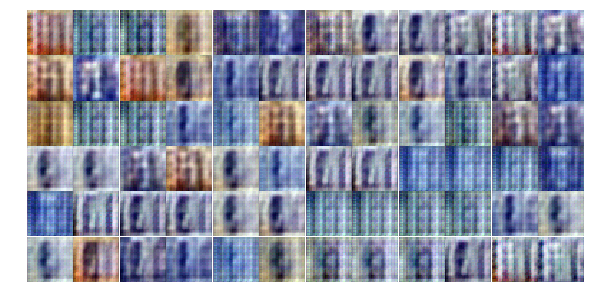

Epoch 9/100... Dloss: -16.2218 Gloss: 29.8369
Epoch 9/100... Dloss: -30.9461 Gloss: 13.8498
Epoch 9/100... Dloss: 1.8483 Gloss: -5.4810
Epoch 9/100... Dloss: -28.1953 Gloss: 50.2793
Epoch 9/100... Dloss: -5.7052 Gloss: 32.7082
Epoch 9/100... Dloss: -44.5865 Gloss: 71.8987
Epoch 9/100... Dloss: -32.7720 Gloss: 58.4614
Epoch 9/100... Dloss: 5.4035 Gloss: 20.0904
Epoch 9/100... Dloss: 16.8248 Gloss: 7.7351
Epoch 9/100... Dloss: 12.1624 Gloss: 21.6696


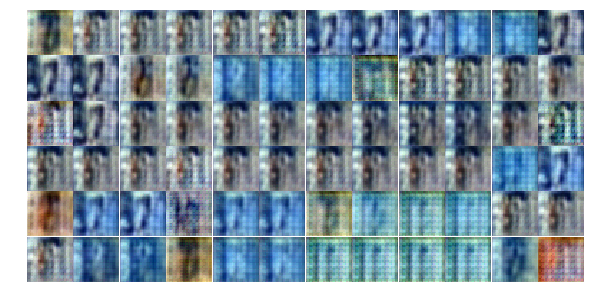

Epoch 9/100... Dloss: 20.6703 Gloss: -16.1704
Epoch 9/100... Dloss: -22.4321 Gloss: 23.4631
Epoch 9/100... Dloss: -11.1346 Gloss: 10.0550
Epoch 9/100... Dloss: 14.2972 Gloss: -8.4007
Epoch 9/100... Dloss: -20.9171 Gloss: 29.9707
Epoch 10/100... Dloss: -14.1052 Gloss: 27.0423
Epoch 10/100... Dloss: 0.8837 Gloss: 30.8212
Epoch 10/100... Dloss: 6.0339 Gloss: 19.3574
Epoch 10/100... Dloss: -6.2933 Gloss: 7.8123
Epoch 10/100... Dloss: -5.7562 Gloss: 21.9074


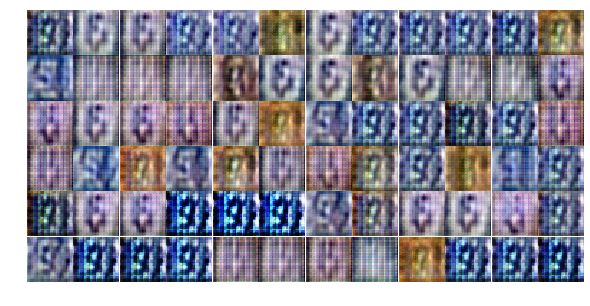

Epoch 10/100... Dloss: -12.4579 Gloss: 21.5915
Epoch 10/100... Dloss: -6.2269 Gloss: 29.8885
Epoch 10/100... Dloss: -0.7879 Gloss: 35.2771
Epoch 10/100... Dloss: -14.2157 Gloss: 17.9861
Epoch 10/100... Dloss: -10.6542 Gloss: 38.0851
Epoch 10/100... Dloss: -18.2854 Gloss: 47.8414
Epoch 10/100... Dloss: -20.0722 Gloss: 39.9640
Epoch 10/100... Dloss: 20.9372 Gloss: 17.8939
Epoch 10/100... Dloss: 7.0042 Gloss: 46.7134
Epoch 10/100... Dloss: -25.6729 Gloss: 43.3962


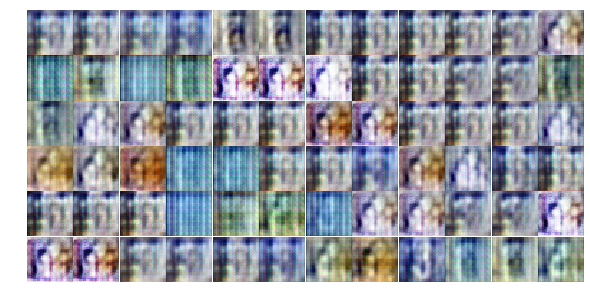

Epoch 10/100... Dloss: -16.0988 Gloss: -2.8931
Epoch 10/100... Dloss: -4.8445 Gloss: -1.4900
Epoch 10/100... Dloss: -9.7926 Gloss: 21.9048
Epoch 10/100... Dloss: -22.9181 Gloss: 9.1872
Epoch 10/100... Dloss: -18.8770 Gloss: 34.0262
Epoch 10/100... Dloss: 5.1471 Gloss: 21.9742
Epoch 10/100... Dloss: -22.7117 Gloss: -8.3656
Epoch 10/100... Dloss: -3.9710 Gloss: 1.2785
Epoch 10/100... Dloss: -10.6453 Gloss: 6.8036
Epoch 10/100... Dloss: -11.0740 Gloss: 14.0645


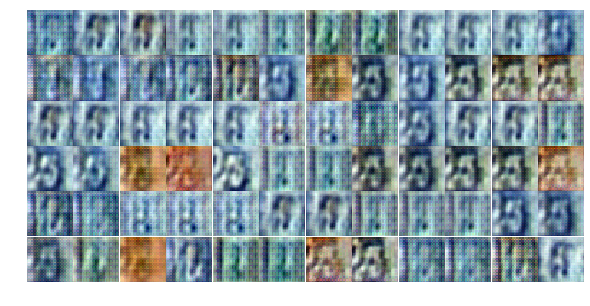

Epoch 10/100... Dloss: -1.3793 Gloss: 12.2360
Epoch 10/100... Dloss: -11.0314 Gloss: -3.8780
Epoch 10/100... Dloss: -13.6012 Gloss: 24.5398
Epoch 10/100... Dloss: -22.9048 Gloss: 41.5615
Epoch 10/100... Dloss: 12.8935 Gloss: 1.1272
Epoch 10/100... Dloss: -22.5895 Gloss: 33.1960
Epoch 10/100... Dloss: -17.3103 Gloss: 23.4133
Epoch 10/100... Dloss: -25.6021 Gloss: 13.1949
Epoch 10/100... Dloss: -13.5231 Gloss: -9.1667
Epoch 10/100... Dloss: -22.6499 Gloss: 36.5658


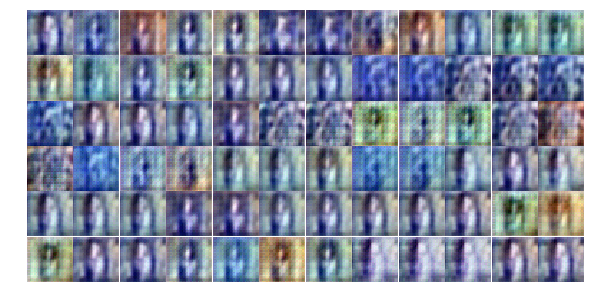

Epoch 10/100... Dloss: -14.6572 Gloss: 29.3707
Epoch 10/100... Dloss: 10.1360 Gloss: 10.0364
Epoch 10/100... Dloss: -22.0921 Gloss: 37.3206
Epoch 10/100... Dloss: -5.0278 Gloss: 17.8510
Epoch 10/100... Dloss: -15.5156 Gloss: 26.6807
Epoch 10/100... Dloss: -3.5451 Gloss: 36.6117
Epoch 10/100... Dloss: -28.8173 Gloss: -1.2190
Epoch 10/100... Dloss: -5.9799 Gloss: 37.9565
Epoch 10/100... Dloss: -17.3723 Gloss: 23.0959
Epoch 10/100... Dloss: -8.6994 Gloss: -7.3756


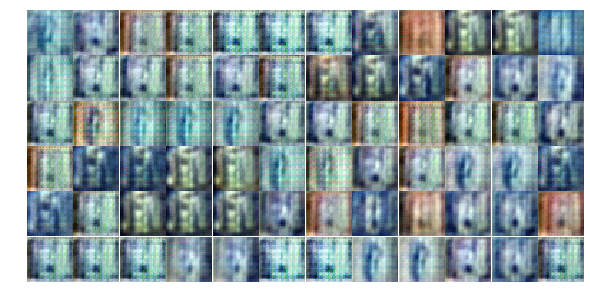

Epoch 10/100... Dloss: 22.3674 Gloss: -26.4447
Epoch 10/100... Dloss: -16.3269 Gloss: 4.3563
Epoch 10/100... Dloss: -5.0349 Gloss: 44.3095
Epoch 10/100... Dloss: -10.4163 Gloss: 20.9711
Epoch 10/100... Dloss: -5.6410 Gloss: 20.1880
Epoch 10/100... Dloss: -21.8130 Gloss: 16.8661
Epoch 10/100... Dloss: -1.7336 Gloss: 26.5964
Epoch 10/100... Dloss: -13.2704 Gloss: -4.2426
Epoch 10/100... Dloss: -18.0693 Gloss: 15.2504
Epoch 10/100... Dloss: -3.8093 Gloss: 32.2701


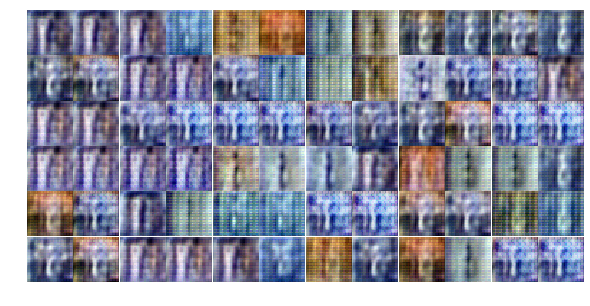

Epoch 10/100... Dloss: -9.6817 Gloss: 19.9110
Epoch 10/100... Dloss: -3.4487 Gloss: 14.1820
Epoch 10/100... Dloss: 0.3324 Gloss: 16.0636
Epoch 11/100... Dloss: -18.0891 Gloss: 34.9594
Epoch 11/100... Dloss: 2.1383 Gloss: 24.2906
Epoch 11/100... Dloss: -21.4481 Gloss: 40.3233
Epoch 11/100... Dloss: 1.5787 Gloss: 41.0561
Epoch 11/100... Dloss: -24.1479 Gloss: 78.0160
Epoch 11/100... Dloss: -13.6595 Gloss: 44.1164
Epoch 11/100... Dloss: -10.3613 Gloss: 29.7039


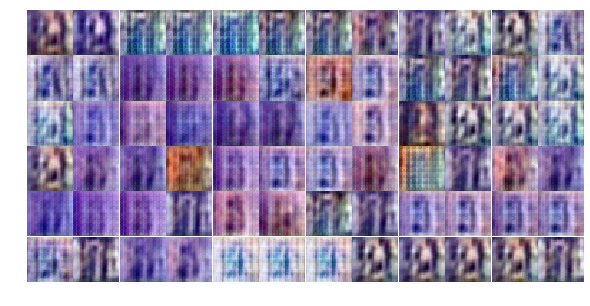

Epoch 11/100... Dloss: -36.8163 Gloss: 45.9495
Epoch 11/100... Dloss: -2.8891 Gloss: 18.3930
Epoch 11/100... Dloss: -51.3405 Gloss: 86.2337
Epoch 11/100... Dloss: -1.8341 Gloss: 47.1406
Epoch 11/100... Dloss: -11.5847 Gloss: 80.2392
Epoch 11/100... Dloss: -19.7832 Gloss: 61.7654
Epoch 11/100... Dloss: -2.7092 Gloss: 34.5858
Epoch 11/100... Dloss: 0.9342 Gloss: -9.7792
Epoch 11/100... Dloss: 12.5025 Gloss: 18.1359
Epoch 11/100... Dloss: -2.2789 Gloss: 13.3766


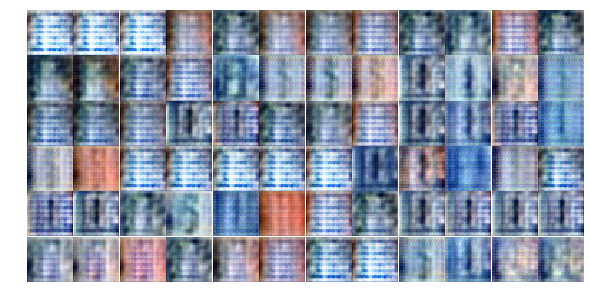

Epoch 11/100... Dloss: -29.2770 Gloss: 47.2913
Epoch 11/100... Dloss: 44.8654 Gloss: -9.5217
Epoch 11/100... Dloss: -3.1897 Gloss: -25.7687
Epoch 11/100... Dloss: -12.0608 Gloss: 19.1069
Epoch 11/100... Dloss: -28.5098 Gloss: 3.6717
Epoch 11/100... Dloss: -5.9179 Gloss: 16.0288
Epoch 11/100... Dloss: -23.0160 Gloss: 32.4752
Epoch 11/100... Dloss: -17.3587 Gloss: 29.9989
Epoch 11/100... Dloss: -23.2664 Gloss: 13.7223
Epoch 11/100... Dloss: -5.3493 Gloss: -11.8305


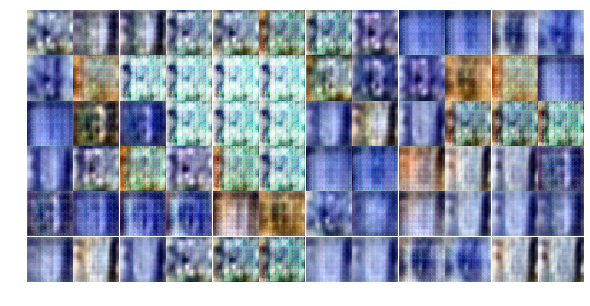

Epoch 11/100... Dloss: -7.6012 Gloss: 6.4581
Epoch 11/100... Dloss: -29.9078 Gloss: 23.5046
Epoch 11/100... Dloss: -28.1861 Gloss: 19.0867
Epoch 11/100... Dloss: -31.9142 Gloss: 49.9447
Epoch 11/100... Dloss: 1.8446 Gloss: 58.6192
Epoch 11/100... Dloss: -18.1141 Gloss: 0.0264
Epoch 11/100... Dloss: -14.3172 Gloss: 45.3242
Epoch 11/100... Dloss: -6.6789 Gloss: 3.0555
Epoch 11/100... Dloss: -19.8334 Gloss: 58.3194
Epoch 11/100... Dloss: 14.9027 Gloss: 39.7598


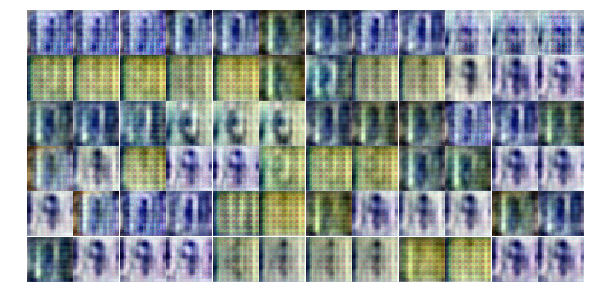

Epoch 11/100... Dloss: -22.0262 Gloss: 80.1631
Epoch 11/100... Dloss: -12.7687 Gloss: 49.5132
Epoch 11/100... Dloss: -16.6673 Gloss: 33.2846
Epoch 11/100... Dloss: 11.9504 Gloss: 30.2008
Epoch 11/100... Dloss: -1.5385 Gloss: 25.6822
Epoch 11/100... Dloss: -8.9902 Gloss: 13.7623
Epoch 11/100... Dloss: -17.2436 Gloss: -11.6209
Epoch 11/100... Dloss: -23.2375 Gloss: 24.2538
Epoch 11/100... Dloss: -0.2308 Gloss: 24.2209
Epoch 11/100... Dloss: -38.6116 Gloss: 26.5621


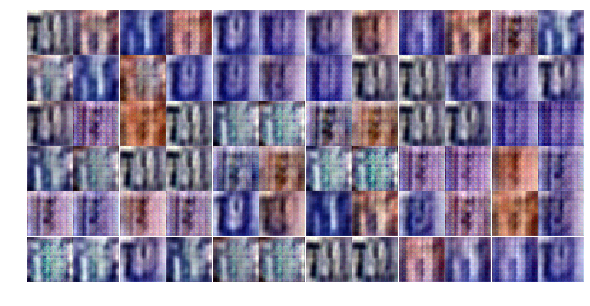

Epoch 11/100... Dloss: -16.9310 Gloss: 57.0362
Epoch 11/100... Dloss: -7.8262 Gloss: 62.3196
Epoch 11/100... Dloss: -21.0483 Gloss: 43.0347
Epoch 11/100... Dloss: -16.0681 Gloss: 60.9224
Epoch 11/100... Dloss: 13.0554 Gloss: 10.7736
Epoch 11/100... Dloss: -43.4759 Gloss: 83.9054
Epoch 11/100... Dloss: -32.2390 Gloss: 26.8221
Epoch 11/100... Dloss: -31.9035 Gloss: 14.4510
Epoch 11/100... Dloss: -11.8687 Gloss: 12.0257
Epoch 11/100... Dloss: -13.7305 Gloss: 25.2793


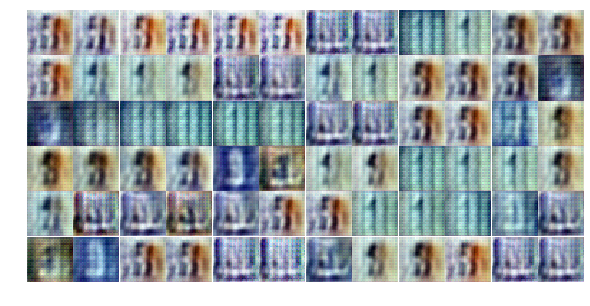

Epoch 12/100... Dloss: -11.6382 Gloss: -0.3567
Epoch 12/100... Dloss: -11.6128 Gloss: 24.9429
Epoch 12/100... Dloss: -25.6034 Gloss: 34.0740
Epoch 12/100... Dloss: -7.9472 Gloss: 15.9261
Epoch 12/100... Dloss: -34.9133 Gloss: 55.1130
Epoch 12/100... Dloss: -33.4467 Gloss: 35.4098
Epoch 12/100... Dloss: -50.3469 Gloss: 61.5870
Epoch 12/100... Dloss: -98.8186 Gloss: 131.5059
Epoch 12/100... Dloss: -38.8436 Gloss: 34.5997
Epoch 12/100... Dloss: -8.5824 Gloss: 93.9039


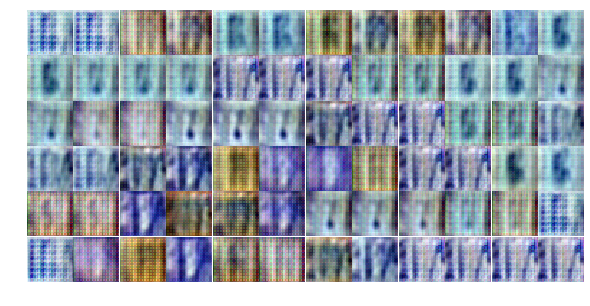

Epoch 12/100... Dloss: -38.5105 Gloss: 100.8972
Epoch 12/100... Dloss: -0.6462 Gloss: 68.9824
Epoch 12/100... Dloss: -21.1016 Gloss: 52.6208
Epoch 12/100... Dloss: 1.1743 Gloss: -2.5670
Epoch 12/100... Dloss: -10.3500 Gloss: 27.9972
Epoch 12/100... Dloss: -13.6797 Gloss: -11.8214
Epoch 12/100... Dloss: -11.7778 Gloss: 23.4819
Epoch 12/100... Dloss: -41.1001 Gloss: 79.6091
Epoch 12/100... Dloss: -42.0818 Gloss: 106.4698
Epoch 12/100... Dloss: -50.1235 Gloss: 79.9211


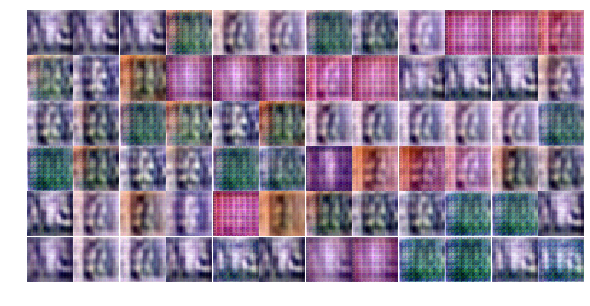

Epoch 12/100... Dloss: 8.5454 Gloss: 23.2445
Epoch 12/100... Dloss: -8.4445 Gloss: 38.8345
Epoch 12/100... Dloss: 7.9082 Gloss: 5.1263
Epoch 12/100... Dloss: -37.6967 Gloss: 31.0389
Epoch 12/100... Dloss: -21.4570 Gloss: 47.5854
Epoch 12/100... Dloss: 9.6840 Gloss: -15.6433
Epoch 12/100... Dloss: -44.7366 Gloss: 101.6481
Epoch 12/100... Dloss: -26.6097 Gloss: 9.7693
Epoch 12/100... Dloss: 7.0996 Gloss: 89.8587
Epoch 12/100... Dloss: -57.8305 Gloss: 72.9739


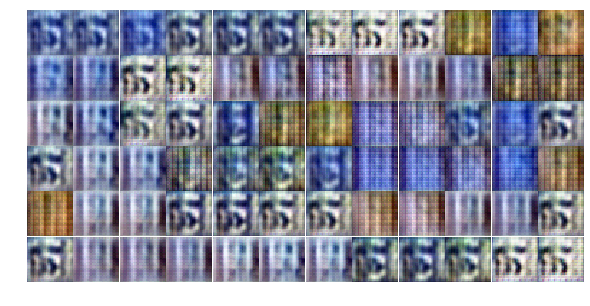

Epoch 12/100... Dloss: -7.3105 Gloss: -38.9447
Epoch 12/100... Dloss: -9.4260 Gloss: 3.3852
Epoch 12/100... Dloss: 23.9027 Gloss: -62.3115
Epoch 12/100... Dloss: -15.1108 Gloss: 2.4866
Epoch 12/100... Dloss: -4.6898 Gloss: 35.2103
Epoch 12/100... Dloss: -32.3637 Gloss: 88.4631
Epoch 12/100... Dloss: -33.4081 Gloss: 28.4698
Epoch 12/100... Dloss: -3.2815 Gloss: 48.7086
Epoch 12/100... Dloss: -46.8675 Gloss: 68.2310
Epoch 12/100... Dloss: 27.8009 Gloss: 51.6189


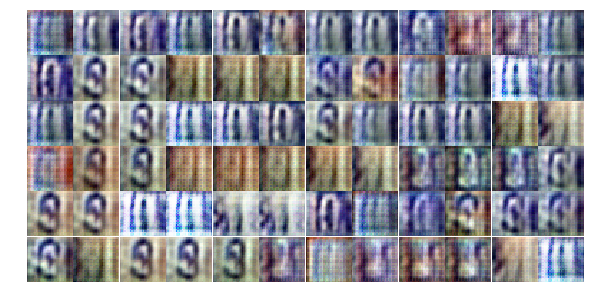

Epoch 12/100... Dloss: -25.3149 Gloss: 62.7957
Epoch 12/100... Dloss: -21.4935 Gloss: 57.8098
Epoch 12/100... Dloss: -1.5570 Gloss: 30.7649
Epoch 12/100... Dloss: 22.9555 Gloss: -50.1172
Epoch 12/100... Dloss: 24.8239 Gloss: -65.2633
Epoch 12/100... Dloss: -6.7368 Gloss: 32.6224
Epoch 12/100... Dloss: -8.7996 Gloss: 62.9373
Epoch 12/100... Dloss: -20.7820 Gloss: 72.8233
Epoch 12/100... Dloss: -14.1423 Gloss: 120.2223
Epoch 12/100... Dloss: 14.8657 Gloss: 62.4466


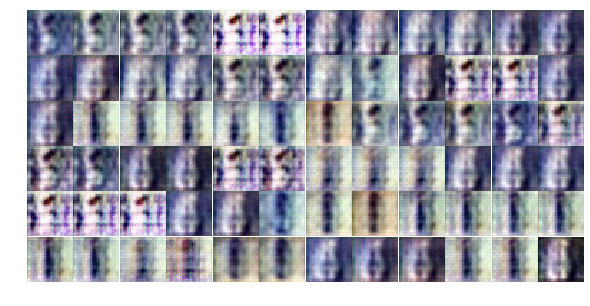

Epoch 12/100... Dloss: -18.8537 Gloss: 34.7858
Epoch 12/100... Dloss: 15.0664 Gloss: 11.6818
Epoch 12/100... Dloss: -38.0600 Gloss: 56.9014
Epoch 12/100... Dloss: -31.9825 Gloss: 35.6944
Epoch 12/100... Dloss: -4.5819 Gloss: 30.7812
Epoch 12/100... Dloss: -27.3499 Gloss: 75.3878
Epoch 12/100... Dloss: -19.4148 Gloss: 52.5129
Epoch 13/100... Dloss: 5.2299 Gloss: -18.8008
Epoch 13/100... Dloss: -27.8940 Gloss: 38.4574
Epoch 13/100... Dloss: 1.6723 Gloss: 48.0270


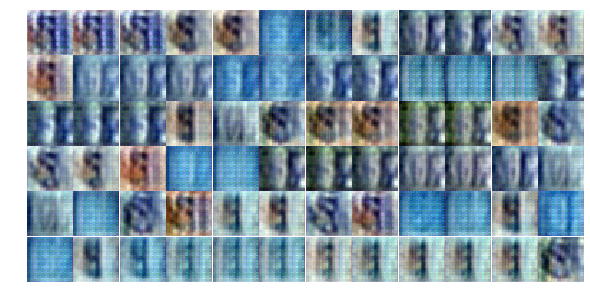

Epoch 13/100... Dloss: -42.3061 Gloss: 90.9116
Epoch 13/100... Dloss: 10.1542 Gloss: 65.0979
Epoch 13/100... Dloss: -6.1447 Gloss: 45.3334
Epoch 13/100... Dloss: 10.2090 Gloss: -5.4363
Epoch 13/100... Dloss: -44.3286 Gloss: 56.6863
Epoch 13/100... Dloss: -0.7393 Gloss: 15.0242
Epoch 13/100... Dloss: -47.4807 Gloss: 37.0097
Epoch 13/100... Dloss: 5.6755 Gloss: 15.4604
Epoch 13/100... Dloss: -12.9703 Gloss: 49.6591
Epoch 13/100... Dloss: -33.8247 Gloss: 107.8023


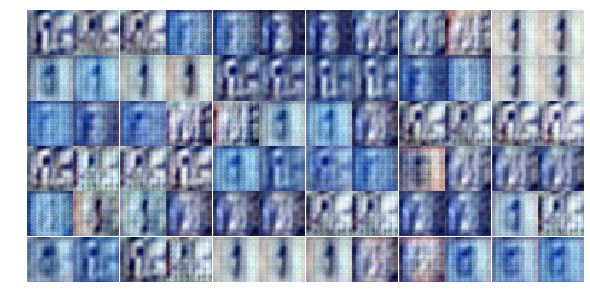

Epoch 13/100... Dloss: -9.3504 Gloss: 48.3575
Epoch 13/100... Dloss: -18.5753 Gloss: 49.7386
Epoch 13/100... Dloss: 4.1875 Gloss: 31.1066
Epoch 13/100... Dloss: -50.2785 Gloss: 74.9173
Epoch 13/100... Dloss: -86.3005 Gloss: 74.1229
Epoch 13/100... Dloss: -18.7110 Gloss: 28.0429
Epoch 13/100... Dloss: -34.0689 Gloss: 37.7043
Epoch 13/100... Dloss: -34.3489 Gloss: 76.9207
Epoch 13/100... Dloss: -47.5959 Gloss: 90.5886
Epoch 13/100... Dloss: 14.2264 Gloss: 36.3267


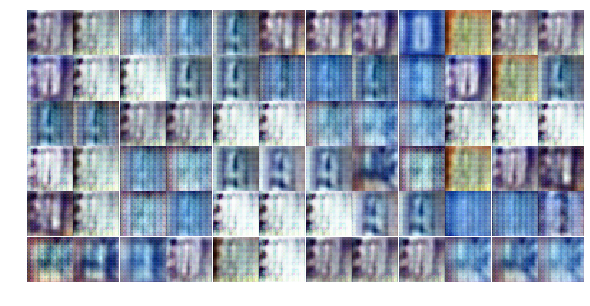

Epoch 13/100... Dloss: -41.4603 Gloss: 39.7775
Epoch 13/100... Dloss: -32.0887 Gloss: 57.8689
Epoch 13/100... Dloss: -47.2017 Gloss: 53.4889
Epoch 13/100... Dloss: -22.7105 Gloss: 62.7542
Epoch 13/100... Dloss: -13.9731 Gloss: 74.4442
Epoch 13/100... Dloss: -9.6509 Gloss: 16.5806
Epoch 13/100... Dloss: -37.4782 Gloss: 57.7558
Epoch 13/100... Dloss: 14.0636 Gloss: 29.1138
Epoch 13/100... Dloss: 0.1368 Gloss: 1.1943
Epoch 13/100... Dloss: -19.4281 Gloss: 45.8536


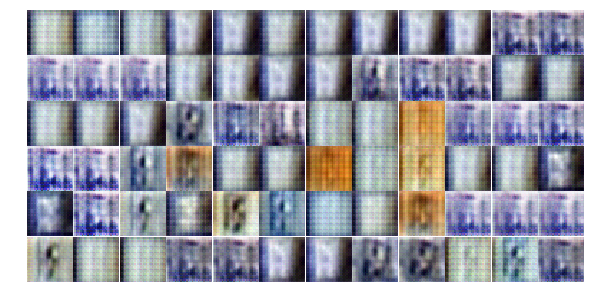

Epoch 13/100... Dloss: -14.6890 Gloss: 50.4480
Epoch 13/100... Dloss: -3.0346 Gloss: 0.6658
Epoch 13/100... Dloss: -12.4022 Gloss: 62.4834
Epoch 13/100... Dloss: -55.5563 Gloss: 93.7492
Epoch 13/100... Dloss: 10.3925 Gloss: 15.3434
Epoch 13/100... Dloss: -17.0031 Gloss: 24.0591
Epoch 13/100... Dloss: -4.3701 Gloss: 70.3976
Epoch 13/100... Dloss: -32.0141 Gloss: 31.1563
Epoch 13/100... Dloss: -16.8514 Gloss: 29.3895
Epoch 13/100... Dloss: -31.3580 Gloss: 8.3673


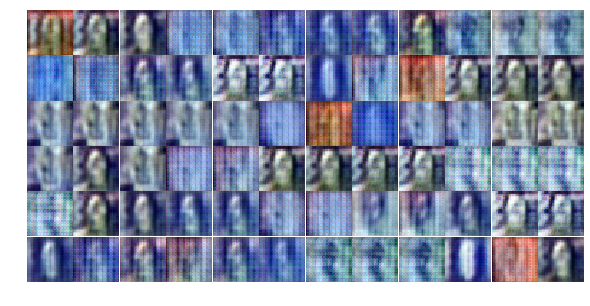

Epoch 13/100... Dloss: -22.8202 Gloss: -15.0789
Epoch 13/100... Dloss: -1.5897 Gloss: -13.1620
Epoch 13/100... Dloss: -25.4562 Gloss: 37.6636
Epoch 13/100... Dloss: -3.9968 Gloss: 27.8927
Epoch 13/100... Dloss: -25.0282 Gloss: 23.1378
Epoch 13/100... Dloss: 6.2944 Gloss: 1.9616
Epoch 13/100... Dloss: -50.9162 Gloss: 59.6565
Epoch 13/100... Dloss: 0.7549 Gloss: 40.9386
Epoch 13/100... Dloss: -30.4011 Gloss: 46.2854
Epoch 13/100... Dloss: -7.0911 Gloss: 27.4609


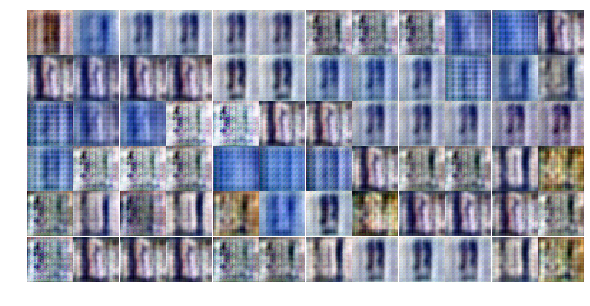

Epoch 13/100... Dloss: -52.0909 Gloss: 56.5813
Epoch 13/100... Dloss: -26.9984 Gloss: 67.4608
Epoch 13/100... Dloss: -13.1665 Gloss: 44.7735
Epoch 13/100... Dloss: -31.4363 Gloss: 59.5434
Epoch 14/100... Dloss: 5.1090 Gloss: 40.9694
Epoch 14/100... Dloss: -19.7299 Gloss: 47.3481
Epoch 14/100... Dloss: -32.7183 Gloss: 85.7370
Epoch 14/100... Dloss: 11.6591 Gloss: 24.8537
Epoch 14/100... Dloss: -21.3545 Gloss: 47.0633
Epoch 14/100... Dloss: -26.0381 Gloss: 53.0064


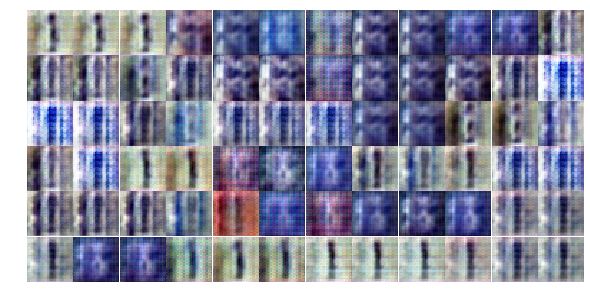

Epoch 14/100... Dloss: -14.6580 Gloss: 31.9141
Epoch 14/100... Dloss: -11.9424 Gloss: 45.6980
Epoch 14/100... Dloss: -11.6224 Gloss: 39.0544
Epoch 14/100... Dloss: -23.6051 Gloss: 38.7876
Epoch 14/100... Dloss: -29.2955 Gloss: 92.4144
Epoch 14/100... Dloss: -3.4219 Gloss: 71.2663
Epoch 14/100... Dloss: 25.6667 Gloss: 12.7433
Epoch 14/100... Dloss: -17.3398 Gloss: 101.4819
Epoch 14/100... Dloss: -16.2768 Gloss: 32.5256
Epoch 14/100... Dloss: -3.2949 Gloss: 23.1539


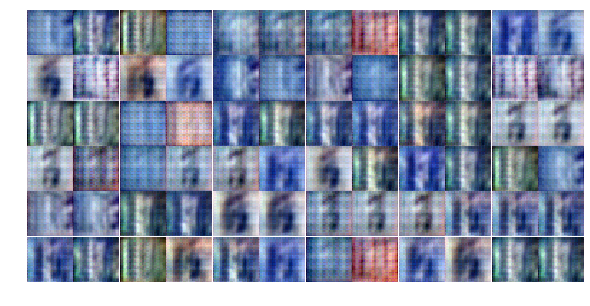

Epoch 14/100... Dloss: -8.5196 Gloss: 87.0757
Epoch 14/100... Dloss: -42.4383 Gloss: 96.6766
Epoch 14/100... Dloss: 21.7271 Gloss: 41.9786
Epoch 14/100... Dloss: -18.2355 Gloss: 68.8335
Epoch 14/100... Dloss: -9.3493 Gloss: 54.6414
Epoch 14/100... Dloss: -23.3836 Gloss: 85.7299
Epoch 14/100... Dloss: 8.3860 Gloss: 14.2910
Epoch 14/100... Dloss: -15.7951 Gloss: 23.2699
Epoch 14/100... Dloss: -25.9311 Gloss: 44.9818
Epoch 14/100... Dloss: -16.0492 Gloss: 44.4485


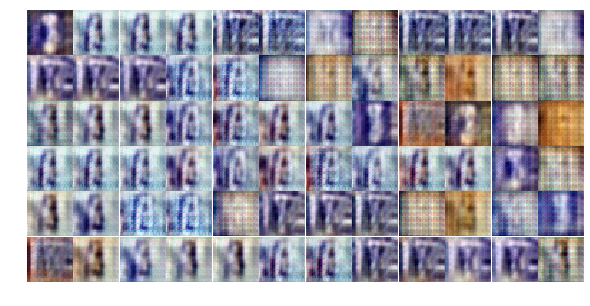

Epoch 14/100... Dloss: -18.4567 Gloss: 66.1348
Epoch 14/100... Dloss: -10.4742 Gloss: 75.7923
Epoch 14/100... Dloss: -22.2363 Gloss: 90.9950
Epoch 14/100... Dloss: 2.5076 Gloss: 56.6796
Epoch 14/100... Dloss: -20.9442 Gloss: 59.9275
Epoch 14/100... Dloss: -35.8603 Gloss: 50.1653
Epoch 14/100... Dloss: -23.9675 Gloss: 49.3959
Epoch 14/100... Dloss: -9.4948 Gloss: 45.6939
Epoch 14/100... Dloss: -24.6221 Gloss: 62.7518
Epoch 14/100... Dloss: -12.3582 Gloss: 48.5029


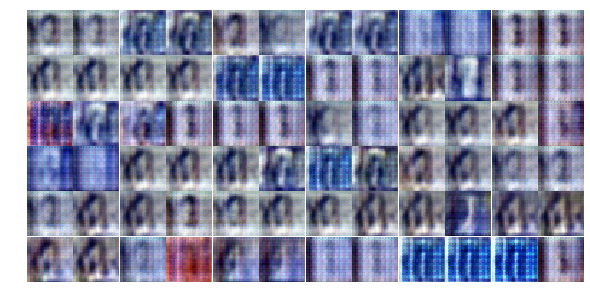

Epoch 14/100... Dloss: 1.2285 Gloss: 33.6163
Epoch 14/100... Dloss: -3.9566 Gloss: 55.7499
Epoch 14/100... Dloss: -31.9583 Gloss: 46.9987
Epoch 14/100... Dloss: 0.0734 Gloss: 57.1484
Epoch 14/100... Dloss: -36.0522 Gloss: 88.0416
Epoch 14/100... Dloss: -12.8115 Gloss: 44.8750
Epoch 14/100... Dloss: -5.7952 Gloss: 54.7054
Epoch 14/100... Dloss: -33.0809 Gloss: 71.3663
Epoch 14/100... Dloss: -21.5081 Gloss: 63.7542
Epoch 14/100... Dloss: 25.7517 Gloss: 38.5453


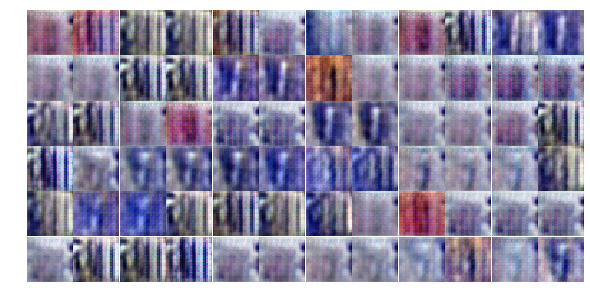

Epoch 14/100... Dloss: -26.9663 Gloss: 74.7457
Epoch 14/100... Dloss: -39.3449 Gloss: 109.4697
Epoch 14/100... Dloss: -9.0042 Gloss: 33.2655
Epoch 14/100... Dloss: 1.8158 Gloss: 39.5248
Epoch 14/100... Dloss: -48.3813 Gloss: 65.4649
Epoch 14/100... Dloss: 26.9379 Gloss: 5.7202
Epoch 14/100... Dloss: -4.9408 Gloss: 17.1347
Epoch 14/100... Dloss: -4.3436 Gloss: 44.2433
Epoch 14/100... Dloss: -2.4535 Gloss: 52.7081
Epoch 14/100... Dloss: -27.8933 Gloss: 57.1328


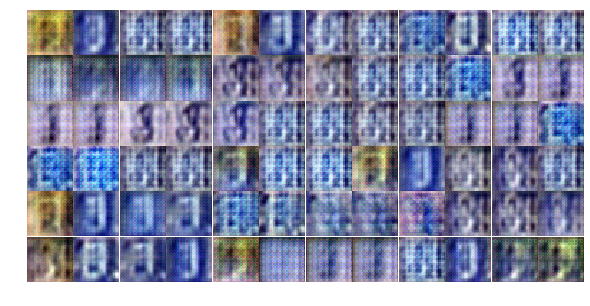

Epoch 14/100... Dloss: -3.0872 Gloss: 38.7886
Epoch 14/100... Dloss: -35.0164 Gloss: 71.1567
Epoch 15/100... Dloss: -8.6881 Gloss: 52.2005
Epoch 15/100... Dloss: -38.0225 Gloss: 51.3805
Epoch 15/100... Dloss: 8.4905 Gloss: 29.5114
Epoch 15/100... Dloss: -19.1220 Gloss: 49.8049
Epoch 15/100... Dloss: -14.9621 Gloss: 53.3913
Epoch 15/100... Dloss: -38.8019 Gloss: 56.2799
Epoch 15/100... Dloss: -7.2581 Gloss: 18.8872
Epoch 15/100... Dloss: -5.4524 Gloss: 25.7912


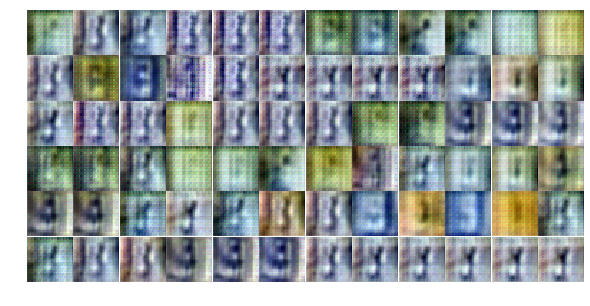

Epoch 15/100... Dloss: -20.5924 Gloss: 49.7742
Epoch 15/100... Dloss: -28.7708 Gloss: 106.8602
Epoch 15/100... Dloss: -10.0265 Gloss: 47.0377
Epoch 15/100... Dloss: -9.9191 Gloss: -3.6304
Epoch 15/100... Dloss: -11.3799 Gloss: 59.9302
Epoch 15/100... Dloss: -32.2576 Gloss: 48.6384
Epoch 15/100... Dloss: 16.3675 Gloss: 2.8668
Epoch 15/100... Dloss: -26.9242 Gloss: 44.9757
Epoch 15/100... Dloss: -18.5908 Gloss: 77.1782
Epoch 15/100... Dloss: -11.3516 Gloss: 70.6993


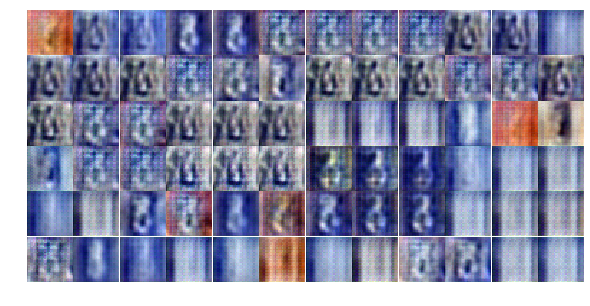

Epoch 15/100... Dloss: 1.7277 Gloss: 62.7708
Epoch 15/100... Dloss: -18.7306 Gloss: 66.9697
Epoch 15/100... Dloss: -18.3202 Gloss: 56.2870
Epoch 15/100... Dloss: 10.3246 Gloss: 30.8235
Epoch 15/100... Dloss: -16.0485 Gloss: 61.4935
Epoch 15/100... Dloss: -8.8022 Gloss: 43.5172
Epoch 15/100... Dloss: -51.9721 Gloss: 78.8750
Epoch 15/100... Dloss: 9.2664 Gloss: 25.0659
Epoch 15/100... Dloss: 3.9422 Gloss: -1.3877
Epoch 15/100... Dloss: 14.3262 Gloss: 10.4073


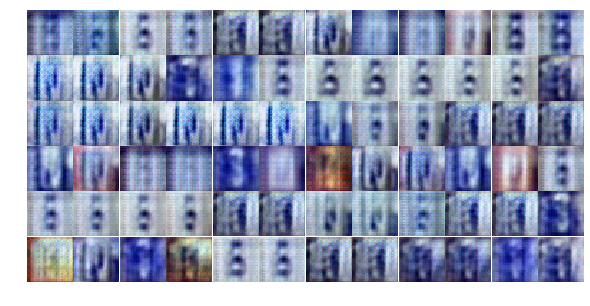

Epoch 15/100... Dloss: -9.0748 Gloss: 52.6461
Epoch 15/100... Dloss: -1.1592 Gloss: 63.2007
Epoch 15/100... Dloss: -8.3858 Gloss: 29.9081
Epoch 15/100... Dloss: -12.8823 Gloss: 5.3603
Epoch 15/100... Dloss: 7.4418 Gloss: 32.6193
Epoch 15/100... Dloss: 0.1387 Gloss: 55.7201
Epoch 15/100... Dloss: -1.0497 Gloss: 66.4686
Epoch 15/100... Dloss: -14.6483 Gloss: 42.9035
Epoch 15/100... Dloss: -42.0946 Gloss: 85.9550
Epoch 15/100... Dloss: -4.3016 Gloss: 80.7693


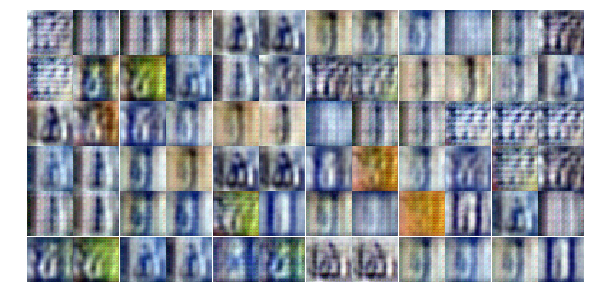

Epoch 15/100... Dloss: 0.0775 Gloss: 44.6005
Epoch 15/100... Dloss: -20.3004 Gloss: 96.1935
Epoch 15/100... Dloss: -14.4594 Gloss: 67.1356
Epoch 15/100... Dloss: 1.1000 Gloss: 42.6774
Epoch 15/100... Dloss: -21.1818 Gloss: 61.7243
Epoch 15/100... Dloss: 8.6969 Gloss: -7.7024
Epoch 15/100... Dloss: 12.2418 Gloss: 18.3818
Epoch 15/100... Dloss: -19.7945 Gloss: 59.2999
Epoch 15/100... Dloss: -5.2056 Gloss: 59.8107
Epoch 15/100... Dloss: -1.3541 Gloss: 49.3857


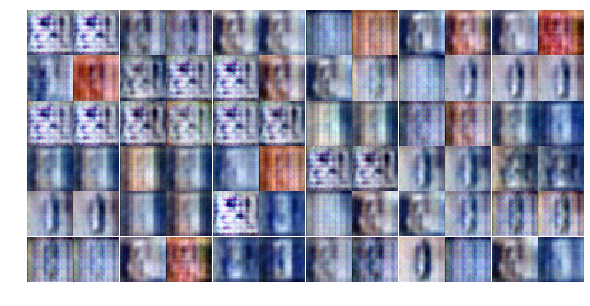

Epoch 15/100... Dloss: -44.1136 Gloss: 58.1291
Epoch 15/100... Dloss: -7.5578 Gloss: 85.8863
Epoch 15/100... Dloss: 12.3646 Gloss: 50.2765
Epoch 15/100... Dloss: -23.4179 Gloss: 70.1888
Epoch 15/100... Dloss: -41.3404 Gloss: 151.1043
Epoch 15/100... Dloss: 15.5417 Gloss: 38.1103
Epoch 15/100... Dloss: -13.1403 Gloss: 29.2557
Epoch 15/100... Dloss: -4.6140 Gloss: 87.6933
Epoch 15/100... Dloss: 36.2325 Gloss: 6.1171
Epoch 16/100... Dloss: -17.9011 Gloss: -6.8463


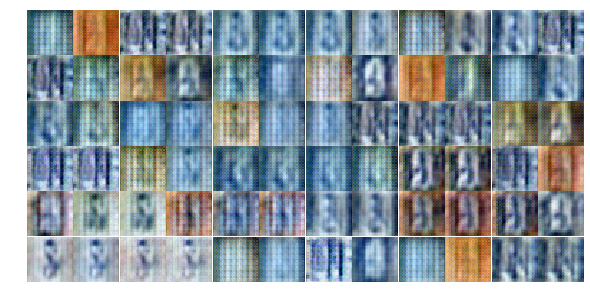

Epoch 16/100... Dloss: -6.7439 Gloss: 25.1921
Epoch 16/100... Dloss: -27.8020 Gloss: 49.3980
Epoch 16/100... Dloss: 6.4147 Gloss: 33.4398
Epoch 16/100... Dloss: -38.8213 Gloss: 89.1042
Epoch 16/100... Dloss: -35.5479 Gloss: 81.1443
Epoch 16/100... Dloss: -12.4644 Gloss: 35.7849
Epoch 16/100... Dloss: -11.8750 Gloss: 22.2070
Epoch 16/100... Dloss: -66.3574 Gloss: 60.1571
Epoch 16/100... Dloss: -13.1346 Gloss: 84.9394
Epoch 16/100... Dloss: -30.4925 Gloss: 115.8661


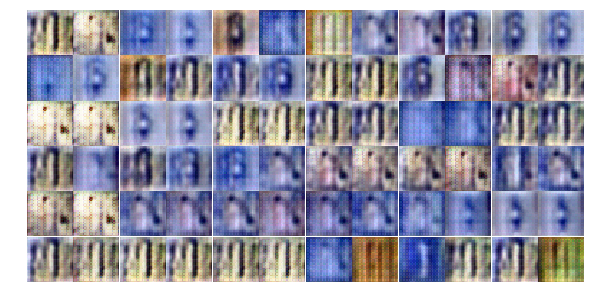

Epoch 16/100... Dloss: 19.1784 Gloss: 37.1376
Epoch 16/100... Dloss: -1.2775 Gloss: 41.2115
Epoch 16/100... Dloss: -37.3816 Gloss: 59.3653
Epoch 16/100... Dloss: -21.7779 Gloss: 84.1052
Epoch 16/100... Dloss: -15.5081 Gloss: 78.2308
Epoch 16/100... Dloss: -61.1163 Gloss: 133.5331
Epoch 16/100... Dloss: -17.5563 Gloss: 72.4844
Epoch 16/100... Dloss: -61.0429 Gloss: 118.1703
Epoch 16/100... Dloss: -12.9530 Gloss: 48.0807
Epoch 16/100... Dloss: -30.9565 Gloss: 80.0535


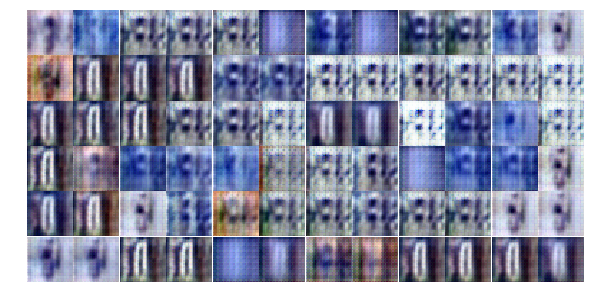

Epoch 16/100... Dloss: -21.2348 Gloss: 62.8892
Epoch 16/100... Dloss: 0.4776 Gloss: 76.2545
Epoch 16/100... Dloss: -16.0182 Gloss: 71.3055
Epoch 16/100... Dloss: -25.2118 Gloss: 39.3405
Epoch 16/100... Dloss: -16.4841 Gloss: 23.4804
Epoch 16/100... Dloss: -48.4574 Gloss: 21.7617
Epoch 16/100... Dloss: -37.5620 Gloss: 15.6279
Epoch 16/100... Dloss: -23.1321 Gloss: 67.1303
Epoch 16/100... Dloss: -31.6886 Gloss: 117.0789
Epoch 16/100... Dloss: -37.6483 Gloss: 82.5157


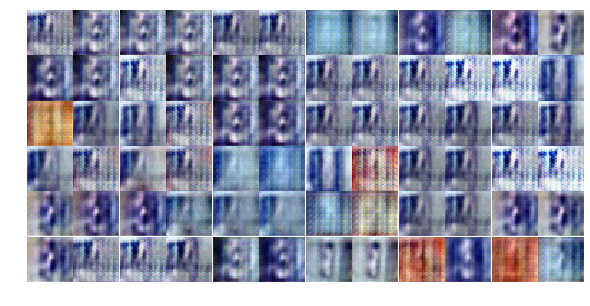

Epoch 16/100... Dloss: -12.6721 Gloss: 45.5682
Epoch 16/100... Dloss: -0.4825 Gloss: 62.4682
Epoch 16/100... Dloss: -59.4576 Gloss: 96.3637
Epoch 16/100... Dloss: -24.4081 Gloss: 63.0280
Epoch 16/100... Dloss: 5.6967 Gloss: 84.0441
Epoch 16/100... Dloss: -24.0898 Gloss: 113.4643
Epoch 16/100... Dloss: -9.0024 Gloss: 145.7313
Epoch 16/100... Dloss: -6.2590 Gloss: 47.2575
Epoch 16/100... Dloss: 22.4982 Gloss: 17.6029
Epoch 16/100... Dloss: -11.8954 Gloss: 7.5598


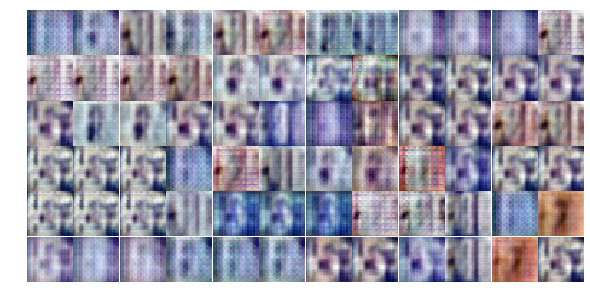

Epoch 16/100... Dloss: -5.2210 Gloss: -39.9942
Epoch 16/100... Dloss: -1.0865 Gloss: -11.0666
Epoch 16/100... Dloss: -21.2347 Gloss: 27.7200
Epoch 16/100... Dloss: -13.6002 Gloss: -33.9101
Epoch 16/100... Dloss: 14.8875 Gloss: -38.1603
Epoch 16/100... Dloss: -24.4368 Gloss: 28.0695
Epoch 16/100... Dloss: -11.8733 Gloss: 9.7011
Epoch 16/100... Dloss: -21.8781 Gloss: 42.3439
Epoch 16/100... Dloss: -19.3843 Gloss: 24.2108
Epoch 16/100... Dloss: 6.4849 Gloss: -19.9363


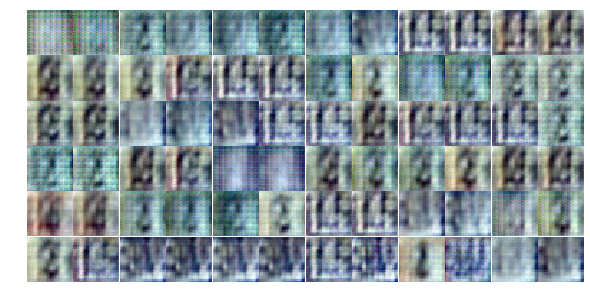

Epoch 16/100... Dloss: -42.2889 Gloss: 71.3008
Epoch 16/100... Dloss: 0.8549 Gloss: 27.3945
Epoch 16/100... Dloss: -10.7472 Gloss: 16.0121
Epoch 16/100... Dloss: -30.8937 Gloss: 46.6433
Epoch 16/100... Dloss: 19.7481 Gloss: -23.4031
Epoch 16/100... Dloss: -32.3100 Gloss: 54.5656
Epoch 17/100... Dloss: -31.1930 Gloss: 24.5014
Epoch 17/100... Dloss: -0.2500 Gloss: -15.2452
Epoch 17/100... Dloss: -0.3074 Gloss: 2.5007
Epoch 17/100... Dloss: 15.4960 Gloss: 5.6814


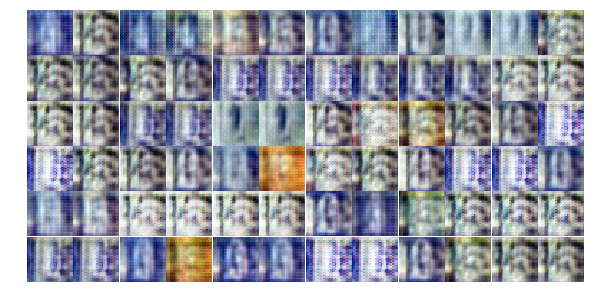

Epoch 17/100... Dloss: -20.2159 Gloss: 39.5354
Epoch 17/100... Dloss: -16.6934 Gloss: 64.3968
Epoch 17/100... Dloss: -20.2372 Gloss: 27.3474
Epoch 17/100... Dloss: -12.1902 Gloss: 46.2126
Epoch 17/100... Dloss: -18.3164 Gloss: 67.1226
Epoch 17/100... Dloss: -33.6815 Gloss: 44.7208
Epoch 17/100... Dloss: -22.3552 Gloss: 72.8908
Epoch 17/100... Dloss: -39.6271 Gloss: 78.2411
Epoch 17/100... Dloss: -0.7747 Gloss: 81.2677
Epoch 17/100... Dloss: -56.5222 Gloss: 145.7048


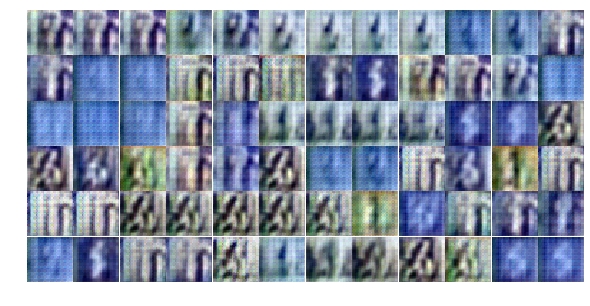

Epoch 17/100... Dloss: -21.3399 Gloss: 94.2129
Epoch 17/100... Dloss: -18.9010 Gloss: 47.4278
Epoch 17/100... Dloss: -0.1471 Gloss: 108.1873
Epoch 17/100... Dloss: -69.7971 Gloss: 61.5651
Epoch 17/100... Dloss: -21.9132 Gloss: 104.3680
Epoch 17/100... Dloss: -3.2826 Gloss: 36.4192
Epoch 17/100... Dloss: -22.1054 Gloss: 56.0602
Epoch 17/100... Dloss: -29.2778 Gloss: 98.9867
Epoch 17/100... Dloss: -66.7895 Gloss: 136.1129
Epoch 17/100... Dloss: -2.0432 Gloss: 42.1165


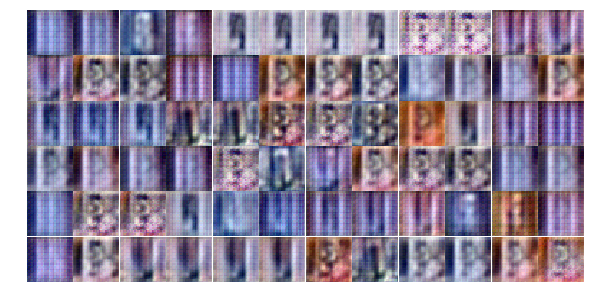

Epoch 17/100... Dloss: 16.5828 Gloss: -8.3391
Epoch 17/100... Dloss: -28.9441 Gloss: 54.0073
Epoch 17/100... Dloss: -16.6391 Gloss: 20.8841
Epoch 17/100... Dloss: 20.4481 Gloss: 30.7552
Epoch 17/100... Dloss: -4.7750 Gloss: 59.3247
Epoch 17/100... Dloss: -33.8905 Gloss: 110.5430
Epoch 17/100... Dloss: 2.8049 Gloss: 11.6108
Epoch 17/100... Dloss: -5.2408 Gloss: -3.4536
Epoch 17/100... Dloss: 14.9032 Gloss: 38.9724
Epoch 17/100... Dloss: -42.6673 Gloss: 90.8214


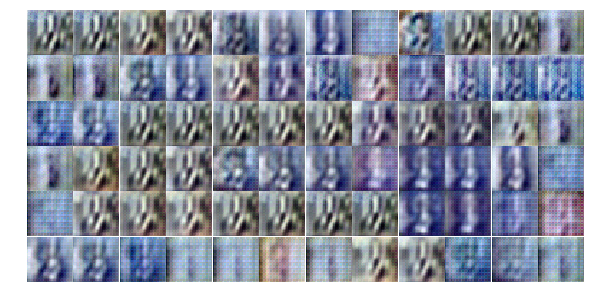

Epoch 17/100... Dloss: -6.8580 Gloss: 62.2787
Epoch 17/100... Dloss: -29.2634 Gloss: 63.8643
Epoch 17/100... Dloss: -0.8331 Gloss: 45.5992
Epoch 17/100... Dloss: 38.9768 Gloss: 56.3253
Epoch 17/100... Dloss: -46.9852 Gloss: 106.7090
Epoch 17/100... Dloss: -25.8340 Gloss: 89.3579
Epoch 17/100... Dloss: -17.6043 Gloss: 79.4853
Epoch 17/100... Dloss: -9.1424 Gloss: 36.1599
Epoch 17/100... Dloss: -27.6397 Gloss: 45.4022
Epoch 17/100... Dloss: -27.2951 Gloss: 118.7783


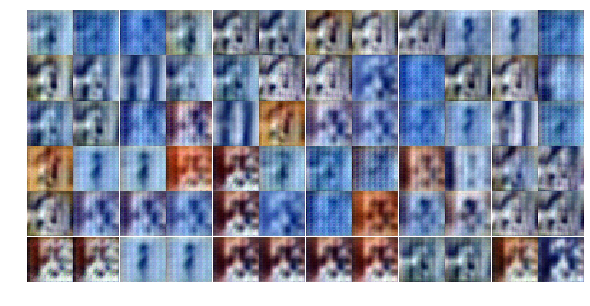

Epoch 17/100... Dloss: -25.5967 Gloss: 28.6427
Epoch 17/100... Dloss: -5.9754 Gloss: 61.6633
Epoch 17/100... Dloss: -26.5813 Gloss: 41.9171
Epoch 17/100... Dloss: 14.0605 Gloss: 93.0175
Epoch 17/100... Dloss: -59.3049 Gloss: 66.4212
Epoch 17/100... Dloss: 0.2218 Gloss: 29.5017
Epoch 17/100... Dloss: 3.0108 Gloss: -14.0911
Epoch 17/100... Dloss: 3.2353 Gloss: -10.2308
Epoch 17/100... Dloss: -7.8489 Gloss: 40.7555
Epoch 17/100... Dloss: -21.2141 Gloss: 54.7605


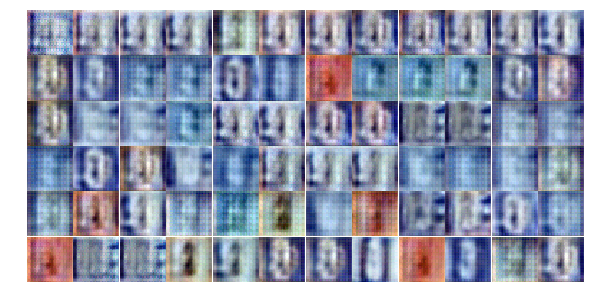

Epoch 17/100... Dloss: -3.4776 Gloss: 48.7788
Epoch 17/100... Dloss: -0.1424 Gloss: 30.7986
Epoch 17/100... Dloss: -57.2576 Gloss: 88.7220
Epoch 17/100... Dloss: -11.2276 Gloss: 54.7411
Epoch 18/100... Dloss: -65.7516 Gloss: 116.1449
Epoch 18/100... Dloss: 12.5422 Gloss: 55.0387
Epoch 18/100... Dloss: 47.1408 Gloss: -31.8970
Epoch 18/100... Dloss: -41.6174 Gloss: 35.9490
Epoch 18/100... Dloss: 8.8342 Gloss: 44.0165
Epoch 18/100... Dloss: -17.1765 Gloss: 75.2175


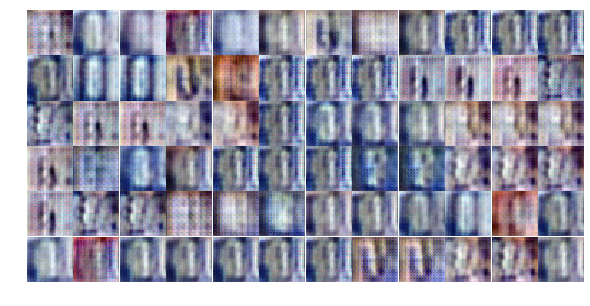

Epoch 18/100... Dloss: -7.7587 Gloss: 47.9936
Epoch 18/100... Dloss: -7.5604 Gloss: 73.4426
Epoch 18/100... Dloss: -54.9533 Gloss: 132.8940
Epoch 18/100... Dloss: -5.0463 Gloss: 85.1366
Epoch 18/100... Dloss: -1.1818 Gloss: 74.2849
Epoch 18/100... Dloss: 8.7537 Gloss: 58.9906
Epoch 18/100... Dloss: -46.6874 Gloss: 109.4267
Epoch 18/100... Dloss: -36.5924 Gloss: 93.0083
Epoch 18/100... Dloss: -31.3225 Gloss: 66.7174
Epoch 18/100... Dloss: -27.4298 Gloss: 85.2623


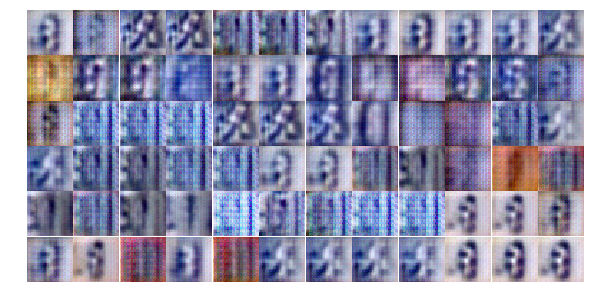

Epoch 18/100... Dloss: -23.5490 Gloss: 74.3561
Epoch 18/100... Dloss: -3.1393 Gloss: 60.4834
Epoch 18/100... Dloss: -38.7186 Gloss: 96.1514
Epoch 18/100... Dloss: -10.0583 Gloss: 68.1718
Epoch 18/100... Dloss: -21.3645 Gloss: 114.5377
Epoch 18/100... Dloss: -20.8326 Gloss: 110.7039
Epoch 18/100... Dloss: -33.2174 Gloss: 76.7153
Epoch 18/100... Dloss: 5.4614 Gloss: 37.0195
Epoch 18/100... Dloss: -37.7703 Gloss: 46.7484
Epoch 18/100... Dloss: -30.4106 Gloss: 97.3504


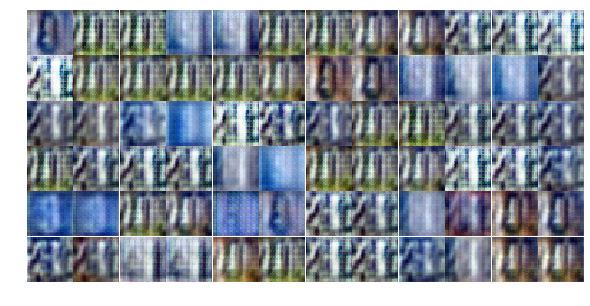

Epoch 18/100... Dloss: 7.4055 Gloss: 33.1959
Epoch 18/100... Dloss: -54.9091 Gloss: 102.0584
Epoch 18/100... Dloss: -0.4130 Gloss: 85.6840
Epoch 18/100... Dloss: -28.0520 Gloss: 55.7928
Epoch 18/100... Dloss: -19.3436 Gloss: 94.0374
Epoch 18/100... Dloss: 14.3884 Gloss: 54.7289
Epoch 18/100... Dloss: -31.4194 Gloss: 90.5116
Epoch 18/100... Dloss: -27.5982 Gloss: 82.8589
Epoch 18/100... Dloss: -20.4943 Gloss: 56.0040
Epoch 18/100... Dloss: -35.7638 Gloss: 95.8074


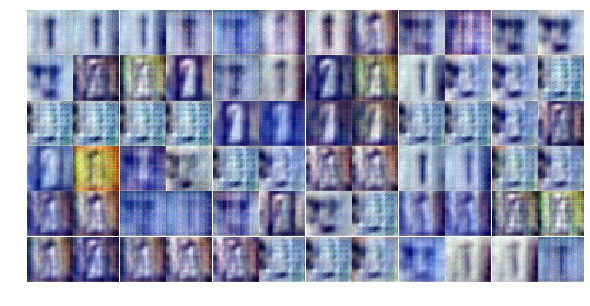

Epoch 18/100... Dloss: 1.6203 Gloss: 100.2552
Epoch 18/100... Dloss: -39.3936 Gloss: 95.1170
Epoch 18/100... Dloss: -69.7611 Gloss: 126.8482
Epoch 18/100... Dloss: -5.9619 Gloss: 65.5321
Epoch 18/100... Dloss: -44.0420 Gloss: 93.9311
Epoch 18/100... Dloss: 4.3663 Gloss: 67.0719
Epoch 18/100... Dloss: 0.8252 Gloss: 109.2599
Epoch 18/100... Dloss: -58.1396 Gloss: 63.7837
Epoch 18/100... Dloss: -22.8433 Gloss: 51.9013
Epoch 18/100... Dloss: -60.6006 Gloss: 99.5236


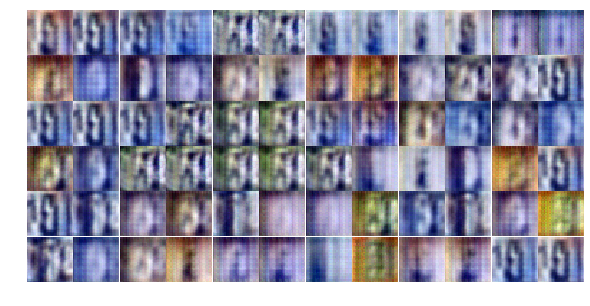

Epoch 18/100... Dloss: -38.9032 Gloss: 80.1493
Epoch 18/100... Dloss: -34.5954 Gloss: 56.0362
Epoch 18/100... Dloss: -46.9015 Gloss: 147.0063
Epoch 18/100... Dloss: 15.9398 Gloss: 77.3687
Epoch 18/100... Dloss: -76.6570 Gloss: 132.6412
Epoch 18/100... Dloss: -44.4883 Gloss: 169.1049
Epoch 18/100... Dloss: -31.6095 Gloss: 167.3686
Epoch 18/100... Dloss: -4.6898 Gloss: 103.7548
Epoch 18/100... Dloss: 0.0915 Gloss: 132.8417
Epoch 18/100... Dloss: -43.6871 Gloss: 132.7583


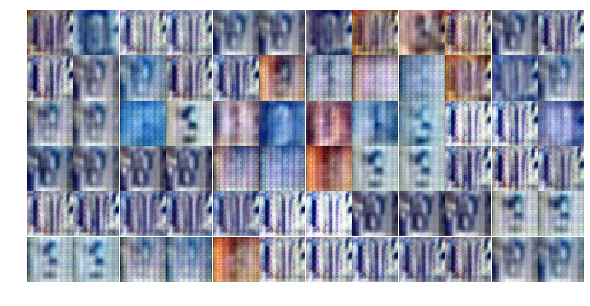

Epoch 18/100... Dloss: -11.2019 Gloss: 107.7534
Epoch 19/100... Dloss: -30.0659 Gloss: 85.3640
Epoch 19/100... Dloss: 13.9186 Gloss: 58.0446
Epoch 19/100... Dloss: -44.6896 Gloss: 118.9191
Epoch 19/100... Dloss: -57.0672 Gloss: 99.2372
Epoch 19/100... Dloss: 0.4444 Gloss: 64.3295
Epoch 19/100... Dloss: -45.2746 Gloss: 34.7638
Epoch 19/100... Dloss: -37.2403 Gloss: 101.2783
Epoch 19/100... Dloss: 2.3654 Gloss: 102.9134
Epoch 19/100... Dloss: -36.4140 Gloss: 119.3591


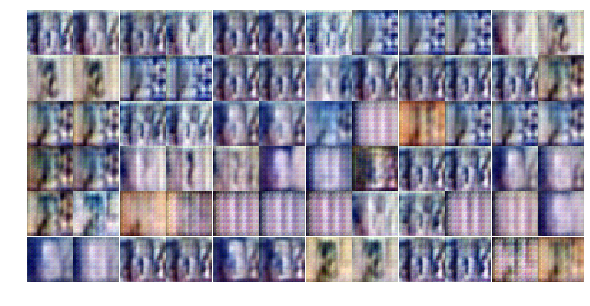

Epoch 19/100... Dloss: -9.5705 Gloss: 144.1056
Epoch 19/100... Dloss: -49.4059 Gloss: 118.6346
Epoch 19/100... Dloss: 13.4031 Gloss: 105.0690
Epoch 19/100... Dloss: -29.1741 Gloss: 128.1716
Epoch 19/100... Dloss: -32.3925 Gloss: 84.7053
Epoch 19/100... Dloss: -30.5375 Gloss: 113.5426
Epoch 19/100... Dloss: -40.4321 Gloss: 151.9365
Epoch 19/100... Dloss: -40.7309 Gloss: 98.9170
Epoch 19/100... Dloss: -33.1789 Gloss: 96.3295
Epoch 19/100... Dloss: -46.7682 Gloss: 97.4483


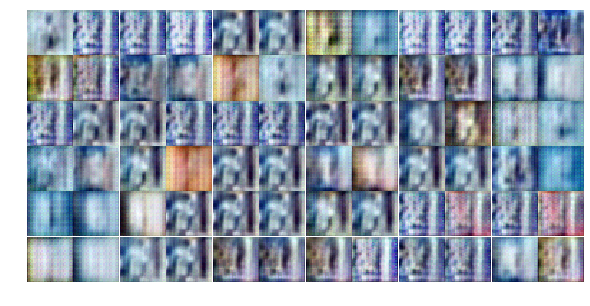

Epoch 19/100... Dloss: -14.8815 Gloss: 135.9883
Epoch 19/100... Dloss: -43.8259 Gloss: 125.3560
Epoch 19/100... Dloss: -20.6687 Gloss: 61.1329
Epoch 19/100... Dloss: 6.5756 Gloss: 88.4619
Epoch 19/100... Dloss: -36.2332 Gloss: 71.3662
Epoch 19/100... Dloss: -29.0849 Gloss: 36.0391
Epoch 19/100... Dloss: -18.1376 Gloss: 13.7048
Epoch 19/100... Dloss: -31.2726 Gloss: 19.1533
Epoch 19/100... Dloss: -56.9767 Gloss: 175.8306
Epoch 19/100... Dloss: -8.2411 Gloss: 79.3266


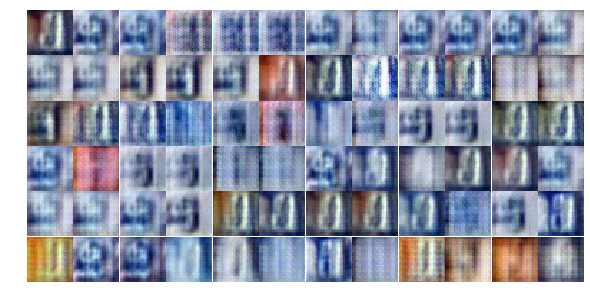

Epoch 19/100... Dloss: -26.3058 Gloss: 23.9069
Epoch 19/100... Dloss: -44.4497 Gloss: 111.3308
Epoch 19/100... Dloss: -39.6990 Gloss: 105.8796
Epoch 19/100... Dloss: -36.9197 Gloss: 37.9139
Epoch 19/100... Dloss: -21.2944 Gloss: 139.0671
Epoch 19/100... Dloss: -50.2974 Gloss: 102.4607
Epoch 19/100... Dloss: -63.9984 Gloss: 108.4651
Epoch 19/100... Dloss: -22.1301 Gloss: 143.9128
Epoch 19/100... Dloss: -4.4383 Gloss: 179.1722
Epoch 19/100... Dloss: -30.8109 Gloss: 137.4875


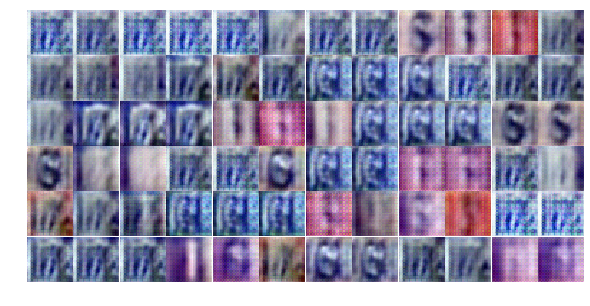

Epoch 19/100... Dloss: 1.6865 Gloss: 129.1859
Epoch 19/100... Dloss: -12.1027 Gloss: 130.1663
Epoch 19/100... Dloss: -3.1033 Gloss: 92.8055
Epoch 19/100... Dloss: 2.1548 Gloss: 32.5110
Epoch 19/100... Dloss: -12.5625 Gloss: 73.6826
Epoch 19/100... Dloss: -16.7161 Gloss: 124.2004
Epoch 19/100... Dloss: -7.6490 Gloss: 131.4986
Epoch 19/100... Dloss: -34.8392 Gloss: 81.8288
Epoch 19/100... Dloss: 11.6401 Gloss: 69.2852
Epoch 19/100... Dloss: -3.7443 Gloss: 116.6087


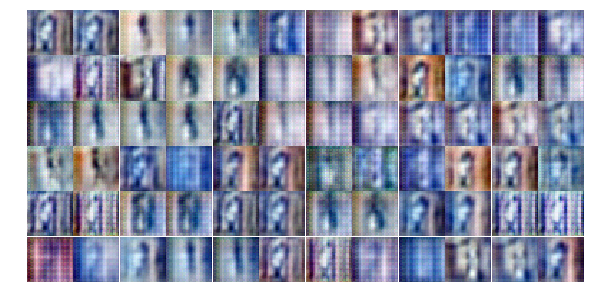

Epoch 19/100... Dloss: -13.5256 Gloss: 120.9145
Epoch 19/100... Dloss: -25.1753 Gloss: 80.5499
Epoch 19/100... Dloss: 2.2967 Gloss: 102.8970
Epoch 19/100... Dloss: -30.5714 Gloss: 150.6197
Epoch 19/100... Dloss: -12.7061 Gloss: 142.5538
Epoch 19/100... Dloss: -21.8373 Gloss: 77.2013
Epoch 19/100... Dloss: 43.2706 Gloss: 57.9109
Epoch 19/100... Dloss: -43.4534 Gloss: 126.8414
Epoch 20/100... Dloss: 9.2132 Gloss: 56.5526
Epoch 20/100... Dloss: -45.6222 Gloss: 127.0016


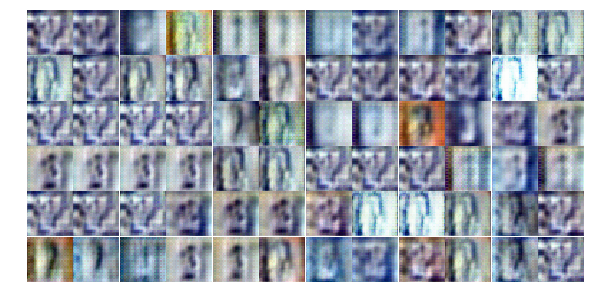

Epoch 20/100... Dloss: 27.7261 Gloss: 95.7209
Epoch 20/100... Dloss: -48.0843 Gloss: 87.1475
Epoch 20/100... Dloss: 20.5710 Gloss: 32.9271
Epoch 20/100... Dloss: -18.7865 Gloss: 49.1702
Epoch 20/100... Dloss: -3.4789 Gloss: 30.4575
Epoch 20/100... Dloss: 1.5908 Gloss: 46.6273
Epoch 20/100... Dloss: -77.8198 Gloss: 99.9672
Epoch 20/100... Dloss: -17.1601 Gloss: 121.5811
Epoch 20/100... Dloss: -29.6242 Gloss: 121.9916
Epoch 20/100... Dloss: 1.8163 Gloss: 57.8985


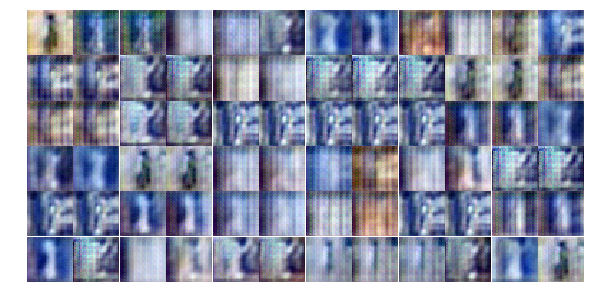

Epoch 20/100... Dloss: -17.7869 Gloss: 106.6462
Epoch 20/100... Dloss: -18.2755 Gloss: 62.7311
Epoch 20/100... Dloss: -2.8743 Gloss: 36.9123
Epoch 20/100... Dloss: -12.4457 Gloss: 73.5298
Epoch 20/100... Dloss: -21.4347 Gloss: 98.0935
Epoch 20/100... Dloss: -18.8797 Gloss: 93.1300
Epoch 20/100... Dloss: -34.4366 Gloss: 114.6449
Epoch 20/100... Dloss: -21.3133 Gloss: 76.0123
Epoch 20/100... Dloss: -19.4300 Gloss: 85.9461
Epoch 20/100... Dloss: -20.0135 Gloss: 43.2952


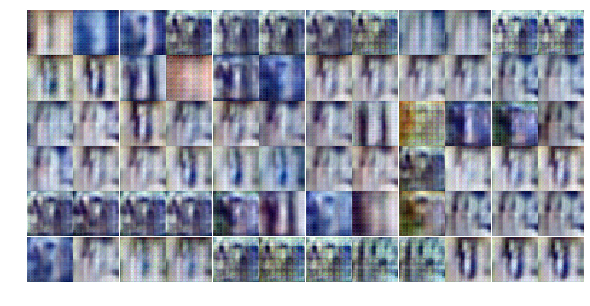

Epoch 20/100... Dloss: -9.3793 Gloss: 46.0907
Epoch 20/100... Dloss: 11.7348 Gloss: 67.3959
Epoch 20/100... Dloss: -58.6850 Gloss: 120.0439
Epoch 20/100... Dloss: -29.8500 Gloss: 72.9630
Epoch 20/100... Dloss: -9.1021 Gloss: 60.5354
Epoch 20/100... Dloss: -36.0557 Gloss: 104.1131
Epoch 20/100... Dloss: -64.8555 Gloss: 131.9432
Epoch 20/100... Dloss: -5.4200 Gloss: 106.1481
Epoch 20/100... Dloss: -8.1454 Gloss: 137.0662
Epoch 20/100... Dloss: -48.9738 Gloss: 162.4788


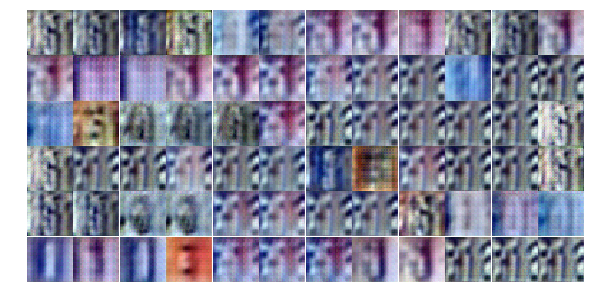

Epoch 20/100... Dloss: 2.4208 Gloss: 101.4977
Epoch 20/100... Dloss: -15.3458 Gloss: 87.9492
Epoch 20/100... Dloss: -14.9368 Gloss: 135.0862
Epoch 20/100... Dloss: -3.2657 Gloss: 95.8940
Epoch 20/100... Dloss: -30.2870 Gloss: 147.1877
Epoch 20/100... Dloss: 43.4862 Gloss: 113.3842
Epoch 20/100... Dloss: -38.5275 Gloss: 103.3751
Epoch 20/100... Dloss: -72.6143 Gloss: 178.6001
Epoch 20/100... Dloss: 11.8001 Gloss: 117.3837
Epoch 20/100... Dloss: -37.1766 Gloss: 111.3043


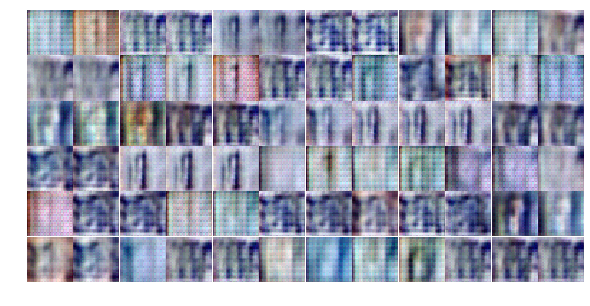

Epoch 20/100... Dloss: 19.4543 Gloss: 58.6681
Epoch 20/100... Dloss: -20.7055 Gloss: 88.5730
Epoch 20/100... Dloss: -36.0288 Gloss: 98.5662
Epoch 20/100... Dloss: 24.1670 Gloss: 58.3095
Epoch 20/100... Dloss: -40.5120 Gloss: 84.7116
Epoch 20/100... Dloss: -13.7598 Gloss: 120.7968
Epoch 20/100... Dloss: -23.7434 Gloss: 124.3813
Epoch 20/100... Dloss: -15.9303 Gloss: 91.3041
Epoch 20/100... Dloss: -2.2042 Gloss: 81.9664
Epoch 20/100... Dloss: -19.3732 Gloss: 96.0427


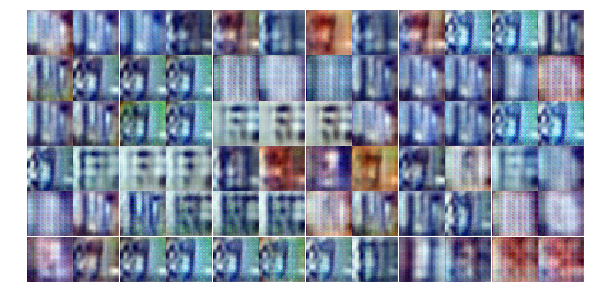

Epoch 20/100... Dloss: -10.7395 Gloss: 118.4087
Epoch 20/100... Dloss: 20.1772 Gloss: 221.3273
Epoch 20/100... Dloss: -40.5719 Gloss: 135.8219
Epoch 20/100... Dloss: 40.8645 Gloss: 118.6713
Epoch 20/100... Dloss: -36.9077 Gloss: 150.4723
Epoch 20/100... Dloss: -9.6315 Gloss: 140.9334
Epoch 21/100... Dloss: -4.3673 Gloss: 91.4050
Epoch 21/100... Dloss: -42.0036 Gloss: 146.9474
Epoch 21/100... Dloss: 19.3555 Gloss: 94.2702
Epoch 21/100... Dloss: -40.7091 Gloss: 166.7672


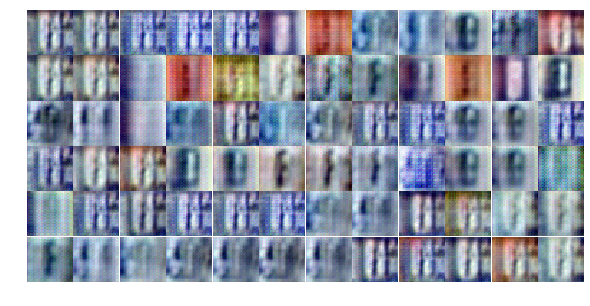

Epoch 21/100... Dloss: -0.3387 Gloss: 139.4298
Epoch 21/100... Dloss: -18.6676 Gloss: 104.0327
Epoch 21/100... Dloss: -3.8467 Gloss: 102.4135
Epoch 21/100... Dloss: -23.7540 Gloss: 110.0408
Epoch 21/100... Dloss: -12.6883 Gloss: 72.3668
Epoch 21/100... Dloss: -21.2441 Gloss: 116.1604
Epoch 21/100... Dloss: -67.7432 Gloss: 94.0738
Epoch 21/100... Dloss: 19.8739 Gloss: 64.7396
Epoch 21/100... Dloss: -30.1160 Gloss: 159.0269
Epoch 21/100... Dloss: 5.3468 Gloss: 111.6182


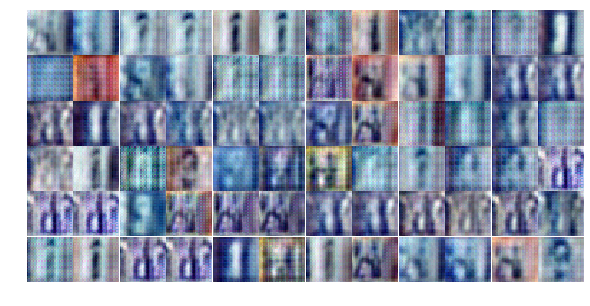

Epoch 21/100... Dloss: -18.6419 Gloss: 148.2117
Epoch 21/100... Dloss: -26.9644 Gloss: 135.7864
Epoch 21/100... Dloss: 3.8158 Gloss: 138.4384
Epoch 21/100... Dloss: 5.1519 Gloss: 137.6094
Epoch 21/100... Dloss: -0.8237 Gloss: 105.7808
Epoch 21/100... Dloss: -46.9417 Gloss: 96.3874
Epoch 21/100... Dloss: -55.8659 Gloss: 117.9028
Epoch 21/100... Dloss: -39.3424 Gloss: 126.5313
Epoch 21/100... Dloss: 15.6795 Gloss: 72.7013
Epoch 21/100... Dloss: -16.5980 Gloss: 143.6053


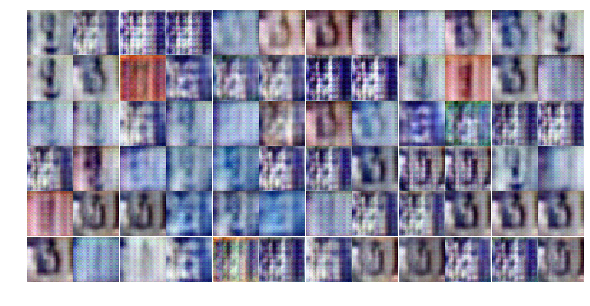

Epoch 21/100... Dloss: 4.6861 Gloss: 110.8348
Epoch 21/100... Dloss: -49.3559 Gloss: 147.9538
Epoch 21/100... Dloss: -3.7378 Gloss: 78.8228


In [ ]:
losses, samples = train(net=net, dataset=dataset, epochs=epochs, batch_size=batch_size, figsize=(10,5))

(57, 3) (57, 3) float32 float32


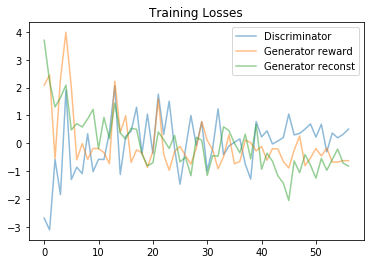

In [21]:
fig, ax = plt.subplots()
losses_ = np.array(losses)
losses_norm = (losses_ - losses_.mean(axis=0))/losses_.std(axis=0)
print(losses_.shape, losses_norm.shape, losses_norm.dtype, losses_norm.dtype)
plt.plot(losses_norm.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses_norm.T[1], label='Generator reward', alpha=0.5)
plt.plot(losses_norm.T[2], label='Generator reconst', alpha=0.5)
plt.title("Training Losses")
plt.legend()

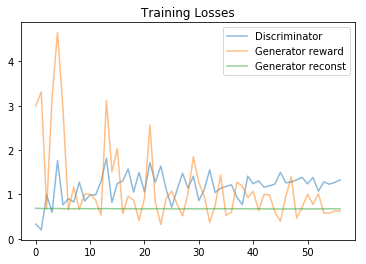

In [22]:
fig, ax = plt.subplots()
losses_ = np.array(losses)
plt.plot(losses_.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses_.T[1], label='Generator reward', alpha=0.5)
plt.plot(losses_.T[2], label='Generator reconst', alpha=0.5)
plt.title("Training Losses")
plt.legend()

/home/arasdar/anaconda3/envs/env/lib/python3.6/site-packages/matplotlib/axes/_base.py:1400: MatplotlibDeprecationWarning: The 'box-forced' keyword argument is deprecated since 2.2.
  " since 2.2.", cbook.mplDeprecation)


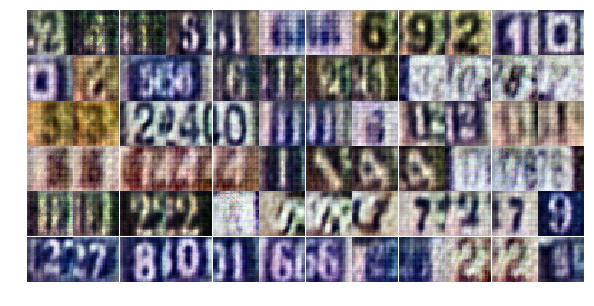

In [23]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))

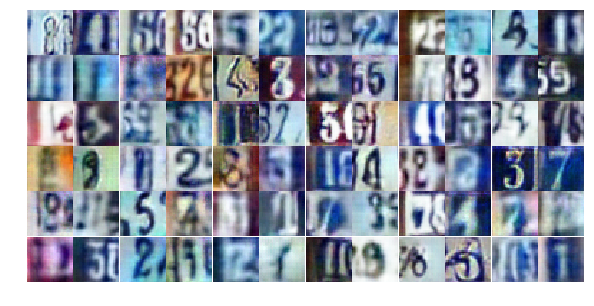

In [19]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))